<div style="background-color: rgba(238, 238, 238, 0.6); padding: 10px; margin-left: 80%"><span style="display: block; color: black; font-size: 24px; text-align: right; font-weight: bold; text-shadow: 2px 2px 4px #999999;">Integrated CA2<br><br></span><span style="display: block; color: black; text-align: right; font-weight: bold; text-shadow: 2px 2px 4px #999999;">Zygimantas Jakubauskas<br></span></div>

<span style="color: blue; text-align: center; font-weight: bold; text-decoration: underline; text-shadow: 2px 2px 4px #999999;">
    
# CA2_Lvl8_integrated
# Data Preparation and Visualisation
# Statistical Techniques for Data Analytics
# Mashine Learning
</span>

<span style="color: blue;">

## Table of contents:
</span>

* [Introduction](#first-bullet)
* [1. Getting familiar with the dataset](#second-bullet)
** [1.1. Data dictionary](#eight-bullet)
* [2. Data Preparation](#third-bullet)
** [2.1. Chracterisation of the Data Set](#fourth-bullet)
** [2.2. Application of Data Preparation Methods and EDA](#ninth-bullet) 
** [2.3. Feature Engineering](#tenth-bullet) 
** [2.4. Dimensionality Reduction](#eleventh-bullet)  
* * * [2.4.1. Principal Component Analysis (PCA)](#21th-bullet)    
* * * [2.4.2. Linear Discriminant Analysis (LDA)](#22th-bullet)       
* [3. Statistical Techniques](#twelwth-bullet)
** [3.1. Descriptive Statistics](#12th-bullet)   
** [3.2. Test Hypothesis](#13th-bullet)    
* * * [3.2.1. T-Test Hypothesis](#19th-bullet)    
* * * [3.2.2. ANOVA Hypothesis](#20th-bullet)      
** [3.3. Result Sets](#14th-bullet)      
* [4. Mashine Learning](#sixth-bullet) 
** [4.1. Selecting Target Variable](#21th-bullet)    
** [4.2. Mashine Learning Models](#16th-bullet)
** [4.3. Hyperparameter Tuning](#17th-bullet)
** [4.4. Cross validation scores using Linear Regression](#23th-bullet)      
* [ Bibliography](#7th-bullet)     

In [1]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt 
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

<span style="color: blue;">

## 1. Getting familiar with the dataset <a class="anchor" id="second-bullet"></a>
    
</span>

In [2]:
df = pd.read_csv("Employee_Attrition.csv")

In [3]:
pd.set_option("display.max_columns", None)

In [4]:
df.head(20)

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,Over18,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41.920786,Yes,Travel_Rarely,990.110009,Sales,1.016716,1.770313,Life Sciences,1.033298,1.054148,2.146294,Male,93.827486,3.426960,2.464492,Sales Executive,3.397665,Single,6438.949336,20845.103714,7.077818,Y,Yes,9.898765,2.844897,1.012832,95.612654,0.000000,8.063833,0.000000,1.052104,5.795945,3.993896,0.000000,4.594972
1,51.589037,No,Travel_Frequently,276.776030,Research & Development,NaN,1.035333,Life Sciences,0.944859,2.107031,3.470803,Male,52.304157,1.813458,1.788697,Research Scientist,1.584059,Married,4457.659622,24877.898697,1.114423,Y,No,NaN,4.120281,4.312008,85.370868,1.104642,8.965059,3.264952,2.526470,10.070232,7.937505,1.032295,5.901207
2,33.131540,Yes,Travel_Rarely,1204.158501,Research & Development,2.198662,2.118801,Other,0.810809,4.008125,3.979420,Male,87.271332,1.877226,0.833488,Laboratory Technician,3.301009,Single,2124.545220,2262.942954,5.539591,Y,Yes,15.401596,2.781168,2.332558,76.248084,0.000000,8.427238,3.004521,2.924784,0.000000,0.000000,0.000000,0.000000
3,34.707073,No,Travel_Frequently,1352.752432,Sales,2.937851,3.670674,Life Sciences,0.822976,4.587269,3.734705,Female,56.378982,2.932646,1.095372,Research Scientist,3.220844,Married,2771.699080,27189.905714,0.772793,NaN,Yes,9.757546,2.769576,3.029591,75.888697,0.000000,7.662606,2.856001,3.117053,8.435324,5.563667,2.845429,0.000000
4,24.790188,No,Travel_Rarely,485.053333,Research & Development,1.988953,1.120496,Medical,NaN,7.228740,1.079412,Male,40.433887,3.117739,0.937746,Laboratory Technician,1.697330,Married,3254.601575,17675.541599,10.118125,NaN,NaN,11.920147,3.282183,NaN,72.670937,0.953012,6.241733,2.814719,3.112317,2.040124,1.970786,2.495949,2.219353
5,29.766336,No,Travel_Frequently,900.495555,Research & Development,1.805415,NaN,Life Sciences,0.911961,8.434914,4.198522,Male,74.570729,2.684099,0.933077,Laboratory Technician,3.283670,Single,3258.643343,11576.351829,0.000000,Y,No,13.474397,3.085446,2.798835,NaN,0.000000,6.694851,1.871592,2.046544,6.092499,8.389254,3.131537,7.060896
6,61.934723,NaN,NaN,1284.456352,Research & Development,2.502578,NaN,Medical,0.842456,11.019992,2.845946,Female,82.238136,3.464390,0.893611,Laboratory Technician,NaN,Married,2659.952996,10226.206619,3.822601,Y,Yes,19.452026,4.473227,0.809695,80.237136,3.190519,11.226132,NaN,2.198286,NaN,0.000000,0.000000,0.000000
7,27.098235,No,Travel_Rarely,NaN,Research & Development,22.329189,0.923262,Life Sciences,0.888357,10.066385,3.194771,Male,73.230392,3.043275,1.223810,NaN,2.933982,Divorced,3091.778600,14958.444688,1.169819,Y,No,21.367034,4.173202,2.062221,75.003287,0.891104,1.058393,1.868045,NaN,0.962310,0.000000,0.000000,0.000000
8,30.379999,NaN,Travel_Frequently,195.346240,Research & Development,NaN,3.209049,Life Sciences,0.834966,13.496344,4.205716,Male,NaN,2.167565,2.748524,NaN,3.079497,Single,10089.717322,8130.111133,0.000000,Y,No,NaN,4.395156,2.156785,91.975003,0.000000,10.088953,1.905135,3.104763,9.894773,7.992665,1.151091,7.080628
9,35.373614,No,Travel_Rarely,1277.914019,Research & Development,28.618060,3.144818,Technical Degree,NaN,12.351803,NaN,Male,100.375750,3.033108,NaN,Healthcare Representative,3.359002,Married,5129.645259,13762.896232,6.934706,Y,No,12.534049,2.895479,1.933506,86.334628,1.947497,18.805415,3.008464,2.105678,5.959244,6.414024,NaN,6.447820


In [5]:
df.shape

(1470, 35)

In [ ]:
<span style="color: blue;">

### 1.1 Data dictionary <a class="anchor" id="eight-bullet"></a>
    
</span>

__Age__ - The age of the employee.

__Attrition__ - Whether or not the employee has left the organization.

__BusinessTravel__ - The frequency of business travel for the employee.

__DailyRate__ - The daily rate of pay for the employee.

__Department__ - The department the employee works in.

__DistanceFromHome__ - The distance from home in miles for the employee.

__Education__ - The level of education achieved by the employee.  Higher number means higher education. 

__EducatoinField__ - The field of study for the employee's education.

__EmployeeCount__ - The number of employees in the organization.

__EmployeeNumber__ - A unique identifier for each employee profile.

__EnvironmentSatisfaction__ - The employee's satisfaction with their work environment. Higher number means better satisfaction.

__Gender__ - The gender of the employee.

__HourlyRate__ - The hourly rate of pay for the employee.

__JobInvolvment__ - The level of involvement required for the employee's job. The higher number means higher involvement.

__JobLevel__ - The job level of the employee. The higher number means higher position within the company.

__JobRole__ - The role of the employee in the organization.

__JobSatisfaction__ - The employee's satisfaction with their job. The higher number means higher job satisfaction.

__MaritalStatus__ - The marital status of the employee.

__MonthlyIncome__ - The monthly income of the employee.

__MonthlyRate__ - The monthly rate of pay for the employee.

__NumCompaniesWorked__ - The number of companies the employee has worked for.

__Over18__ - Whether or not the employee is over 18.

__OverTime__ - Whether or not the employee works overtime.

__PercentSalaryHike__ - The percentage of salary hike for the employee.

__PerformanceRating__ - The performance rating of the employee. The higher number means higjer rating.

__RelationshipSatisfaction__ - The employee's satisfaction with their relationships. There are 4 levels. 1 - Low, 2 - Medium, 3 - High, 4 - Very High.

__StandardHours__ - The standard hours of work for the employee.

__StockOptionLevel__ - The stock option level of the employee.

__TotalWorkingYears__ - The total number of years the employee has worked.

__TrainingTimesLastYear__ - The number of times the employee was taken for training in the last year.

__WorkLifeBalance__ - The employee's perception of their work-life balance. The higher number means better work-life balance.

__YearsAtCompany__ - The number of years the employee has been with the company.

__YearsInCurrentRole__ - The number of years the employee has been in their current role.

__YearsSinceLastPromotion__ - The number of years since the employee's last promotion.


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 35 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Age                       1323 non-null   float64
 1   Attrition                 1323 non-null   object 
 2   BusinessTravel            1323 non-null   object 
 3   DailyRate                 1323 non-null   float64
 4   Department                1323 non-null   object 
 5   DistanceFromHome          1323 non-null   float64
 6   Education                 1323 non-null   float64
 7   EducationField            1323 non-null   object 
 8   EmployeeCount             1323 non-null   float64
 9   EmployeeNumber            1323 non-null   float64
 10  EnvironmentSatisfaction   1323 non-null   float64
 11  Gender                    1323 non-null   object 
 12  HourlyRate                1323 non-null   float64
 13  JobInvolvement            1323 non-null   float64
 14  JobLevel

<span style="color: blue;">

## 2. Data preparation <a class="anchor" id="third-bullet"></a>
    
</span>

<span style="color: blue;">

### 2.1. Characterisation of the Data Set <a class="anchor" id="fourth-bullet"></a>
    
</span>

Checking dataset for duplicates and missing values.

In [7]:
df.duplicated().value_counts()

False    1470
dtype: int64

In [8]:
df.isnull().sum()

Age                         147
Attrition                   147
BusinessTravel              147
DailyRate                   147
Department                  147
DistanceFromHome            147
Education                   147
EducationField              147
EmployeeCount               147
EmployeeNumber              147
EnvironmentSatisfaction     147
Gender                      147
HourlyRate                  147
JobInvolvement              147
JobLevel                    147
JobRole                     147
JobSatisfaction             147
MaritalStatus               147
MonthlyIncome               147
MonthlyRate                 147
NumCompaniesWorked          147
Over18                      147
OverTime                    147
PercentSalaryHike           147
PerformanceRating           147
RelationshipSatisfaction    147
StandardHours               147
StockOptionLevel            147
TotalWorkingYears           147
TrainingTimesLastYear       147
WorkLifeBalance             147
YearsAtC

In [9]:
df.describe(include = "all")

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,Over18,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
count,1323.000000,1323,1323,1323.000000,1323,1323.000000,1323.000000,1323,1323.000000,1323.000000,1323.000000,1323,1323.000000,1323.000000,1323.000000,1323,1323.000000,1323,1323.000000,1323.000000,1323.000000,1323,1323,1323.000000,1323.000000,1323.000000,1323.000000,1323.000000,1323.000000,1323.000000,1323.000000,1323.000000,1323.000000,1323.000000,1323.000000
unique,NaN,2,3,NaN,3,NaN,NaN,6,NaN,NaN,NaN,2,NaN,NaN,NaN,9,NaN,3,NaN,NaN,NaN,1,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,NaN,No,Travel_Rarely,NaN,Research & Development,NaN,NaN,Life Sciences,NaN,NaN,NaN,Male,NaN,NaN,NaN,Sales Executive,NaN,Married,NaN,NaN,NaN,Y,No,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,NaN,1065,890,NaN,824,NaN,NaN,504,NaN,NaN,NaN,783,NaN,NaN,NaN,281,NaN,596,NaN,NaN,NaN,1323,929,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,36.635268,NaN,NaN,802.030050,NaN,9.091097,2.923447,NaN,0.999325,1026.679166,2.726443,NaN,65.647722,2.743028,2.058270,NaN,2.715272,NaN,6544.718401,14364.334764,2.654394,NaN,NaN,15.295717,3.149344,2.720431,80.241313,0.814757,11.426152,2.811756,2.762825,6.933624,4.233363,2.160710,4.117695
std,9.882161,NaN,NaN,414.031025,NaN,8.177870,1.072203,NaN,0.099656,610.480802,1.129679,NaN,21.469709,0.765568,1.127018,NaN,1.146786,NaN,4766.580903,7269.420895,2.508952,NaN,NaN,3.995702,0.476027,1.115959,8.022535,0.863076,8.075870,1.329044,0.761802,6.046798,3.658111,3.221481,3.594053
min,14.544608,NaN,NaN,86.828045,NaN,0.750112,0.770362,NaN,0.628985,1.054148,0.759655,NaN,23.855272,0.722008,0.715172,NaN,0.724192,NaN,891.481007,1567.502382,0.000000,NaN,NaN,7.684723,2.116951,0.720696,53.793059,0.000000,0.000000,0.000000,0.799138,0.000000,0.000000,0.000000,0.000000
25%,29.624982,NaN,NaN,456.479553,NaN,2.147069,2.122706,NaN,0.931146,501.854842,1.894818,NaN,47.701897,2.177638,1.045228,NaN,1.846039,NaN,2961.844066,8138.576694,0.948843,NaN,NaN,12.195197,2.845502,1.909010,74.882946,0.000000,5.953221,1.967328,2.193390,2.673269,1.824392,0.000000,1.687177
50%,34.951950,NaN,NaN,782.958705,NaN,6.920808,3.015658,NaN,0.998949,1022.025017,2.887313,NaN,64.934490,2.859143,1.936150,NaN,2.895032,NaN,4957.070475,14258.293365,1.708812,NaN,NaN,14.495151,3.064551,2.891235,80.351400,0.913651,9.306742,2.690934,2.899807,5.422160,2.968874,0.967140,2.939240
75%,42.748741,NaN,NaN,1130.577949,NaN,13.584900,3.700560,NaN,1.067371,1533.811096,3.676600,NaN,83.038355,3.179128,2.609707,NaN,3.676663,NaN,8268.002496,20322.279885,3.959710,NaN,NaN,17.745736,3.335525,3.639961,85.664169,1.082523,15.324548,3.366949,3.206117,9.238005,7.052591,2.586631,6.987964


<span style="color: blue;">

### 2.2. Application of Data Preparation Methods and EDA <a class="anchor" id="ninth-bullet"></a>
    
</span>

In [10]:
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,Over18,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41.920786,Yes,Travel_Rarely,990.110009,Sales,1.016716,1.770313,Life Sciences,1.033298,1.054148,2.146294,Male,93.827486,3.426960,2.464492,Sales Executive,3.397665,Single,6438.949336,20845.103714,7.077818,Y,Yes,9.898765,2.844897,1.012832,95.612654,0.000000,8.063833,0.000000,1.052104,5.795945,3.993896,0.000000,4.594972
1,51.589037,No,Travel_Frequently,276.776030,Research & Development,NaN,1.035333,Life Sciences,0.944859,2.107031,3.470803,Male,52.304157,1.813458,1.788697,Research Scientist,1.584059,Married,4457.659622,24877.898697,1.114423,Y,No,NaN,4.120281,4.312008,85.370868,1.104642,8.965059,3.264952,2.526470,10.070232,7.937505,1.032295,5.901207
2,33.131540,Yes,Travel_Rarely,1204.158501,Research & Development,2.198662,2.118801,Other,0.810809,4.008125,3.979420,Male,87.271332,1.877226,0.833488,Laboratory Technician,3.301009,Single,2124.545220,2262.942954,5.539591,Y,Yes,15.401596,2.781168,2.332558,76.248084,0.000000,8.427238,3.004521,2.924784,0.000000,0.000000,0.000000,0.000000
3,34.707073,No,Travel_Frequently,1352.752432,Sales,2.937851,3.670674,Life Sciences,0.822976,4.587269,3.734705,Female,56.378982,2.932646,1.095372,Research Scientist,3.220844,Married,2771.699080,27189.905714,0.772793,NaN,Yes,9.757546,2.769576,3.029591,75.888697,0.000000,7.662606,2.856001,3.117053,8.435324,5.563667,2.845429,0.000000
4,24.790188,No,Travel_Rarely,485.053333,Research & Development,1.988953,1.120496,Medical,NaN,7.228740,1.079412,Male,40.433887,3.117739,0.937746,Laboratory Technician,1.697330,Married,3254.601575,17675.541599,10.118125,NaN,NaN,11.920147,3.282183,NaN,72.670937,0.953012,6.241733,2.814719,3.112317,2.040124,1.970786,2.495949,2.219353


Dropping columns that don't have any impact on the dataset. 

In [11]:
df.drop(["Over18", "EmployeeNumber"], axis=1, inplace=True)
pd.set_option("display.max_columns", None)
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41.920786,Yes,Travel_Rarely,990.110009,Sales,1.016716,1.770313,Life Sciences,1.033298,2.146294,Male,93.827486,3.426960,2.464492,Sales Executive,3.397665,Single,6438.949336,20845.103714,7.077818,Yes,9.898765,2.844897,1.012832,95.612654,0.000000,8.063833,0.000000,1.052104,5.795945,3.993896,0.000000,4.594972
1,51.589037,No,Travel_Frequently,276.776030,Research & Development,NaN,1.035333,Life Sciences,0.944859,3.470803,Male,52.304157,1.813458,1.788697,Research Scientist,1.584059,Married,4457.659622,24877.898697,1.114423,No,NaN,4.120281,4.312008,85.370868,1.104642,8.965059,3.264952,2.526470,10.070232,7.937505,1.032295,5.901207
2,33.131540,Yes,Travel_Rarely,1204.158501,Research & Development,2.198662,2.118801,Other,0.810809,3.979420,Male,87.271332,1.877226,0.833488,Laboratory Technician,3.301009,Single,2124.545220,2262.942954,5.539591,Yes,15.401596,2.781168,2.332558,76.248084,0.000000,8.427238,3.004521,2.924784,0.000000,0.000000,0.000000,0.000000
3,34.707073,No,Travel_Frequently,1352.752432,Sales,2.937851,3.670674,Life Sciences,0.822976,3.734705,Female,56.378982,2.932646,1.095372,Research Scientist,3.220844,Married,2771.699080,27189.905714,0.772793,Yes,9.757546,2.769576,3.029591,75.888697,0.000000,7.662606,2.856001,3.117053,8.435324,5.563667,2.845429,0.000000
4,24.790188,No,Travel_Rarely,485.053333,Research & Development,1.988953,1.120496,Medical,NaN,1.079412,Male,40.433887,3.117739,0.937746,Laboratory Technician,1.697330,Married,3254.601575,17675.541599,10.118125,NaN,11.920147,3.282183,NaN,72.670937,0.953012,6.241733,2.814719,3.112317,2.040124,1.970786,2.495949,2.219353


Creating copy of dataset for future use.

In [12]:
df_mv = df.copy()

Rounding up some variables where it does make sense.

In [13]:
df[["Age", "NumCompaniesWorked", "TrainingTimesLastYear"]] = np.round(df[["Age", "NumCompaniesWorked", "TrainingTimesLastYear"]])
df[["StandardHours", "TotalWorkingYears", "YearsAtCompany", "YearsInCurrentRole", "YearsSinceLastPromotion", "YearsWithCurrManager"]] = df[["StandardHours", "TotalWorkingYears", "YearsAtCompany", "YearsInCurrentRole", "YearsSinceLastPromotion", "YearsWithCurrManager"]].round(decimals=1)
df[["DistanceFromHome", "DailyRate", "HourlyRate", "MonthlyIncome"]] = df[["DistanceFromHome", "DailyRate", "HourlyRate", "MonthlyIncome"]].round(decimals=2)
pd.options.display.float_format = "{:g}".format

In [14]:
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,42,Yes,Travel_Rarely,990.11,Sales,1.02,1.77031,Life Sciences,1.0333,2.14629,Male,93.83,3.42696,2.46449,Sales Executive,3.39767,Single,6438.95,20845.1,7,Yes,9.89877,2.8449,1.01283,95.6,0,8.1,0,1.0521,5.8,4,0,4.6
1,52,No,Travel_Frequently,276.78,Research & Development,NaN,1.03533,Life Sciences,0.944859,3.4708,Male,52.3,1.81346,1.7887,Research Scientist,1.58406,Married,4457.66,24877.9,1,No,NaN,4.12028,4.31201,85.4,1.10464,9,3,2.52647,10.1,7.9,1,5.9
2,33,Yes,Travel_Rarely,1204.16,Research & Development,2.2,2.1188,Other,0.810809,3.97942,Male,87.27,1.87723,0.833488,Laboratory Technician,3.30101,Single,2124.55,2262.94,6,Yes,15.4016,2.78117,2.33256,76.2,0,8.4,3,2.92478,0,0,0,0
3,35,No,Travel_Frequently,1352.75,Sales,2.94,3.67067,Life Sciences,0.822976,3.7347,Female,56.38,2.93265,1.09537,Research Scientist,3.22084,Married,2771.7,27189.9,1,Yes,9.75755,2.76958,3.02959,75.9,0,7.7,3,3.11705,8.4,5.6,2.8,0
4,25,No,Travel_Rarely,485.05,Research & Development,1.99,1.1205,Medical,NaN,1.07941,Male,40.43,3.11774,0.937746,Laboratory Technician,1.69733,Married,3254.6,17675.5,10,NaN,11.9201,3.28218,NaN,72.7,0.953012,6.2,3,3.11232,2,2,2.5,2.2


Next step is imputing mssing values. Different methods are used. Starting with regressive imputation, Bayesian Ridge model is imported. Heatmap is used to see the relationshiops between the values.

In [15]:
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.linear_model import BayesianRidge

Checking corelations to decide which variables corelate best so missing values can be imputed using regressions.

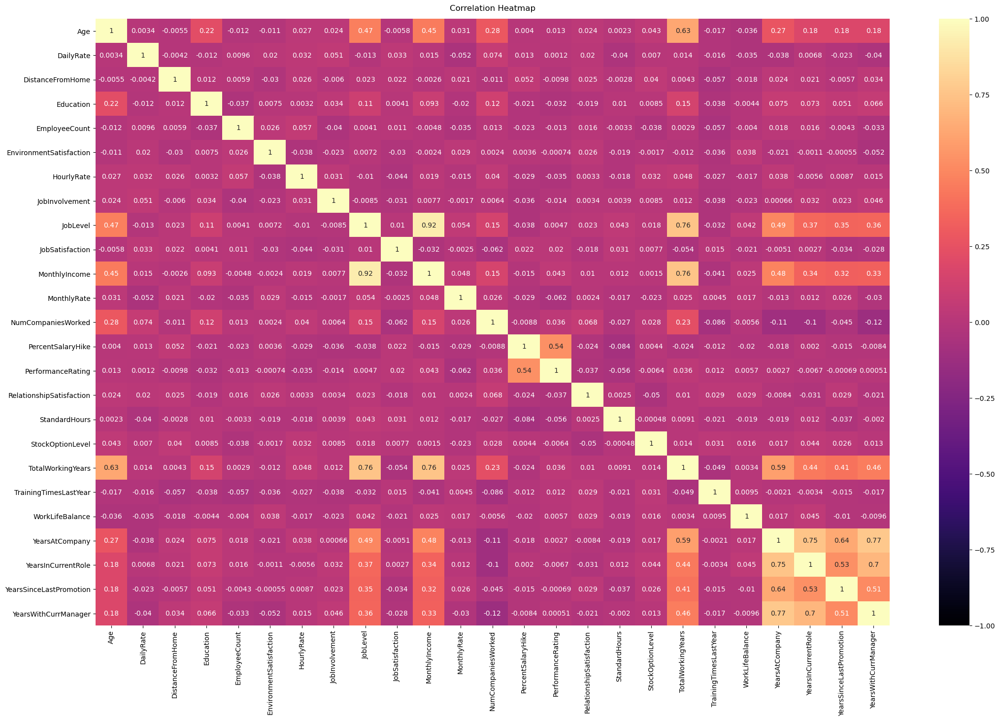

In [16]:
plt.figure(figsize=(26, 16))
heatmap = sns.heatmap(df.corr(), vmin=-1, vmax=1, cmap="magma", annot=True)
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':12}, pad=12);

Variables with best corelations taken separately to create smaller heatmap.

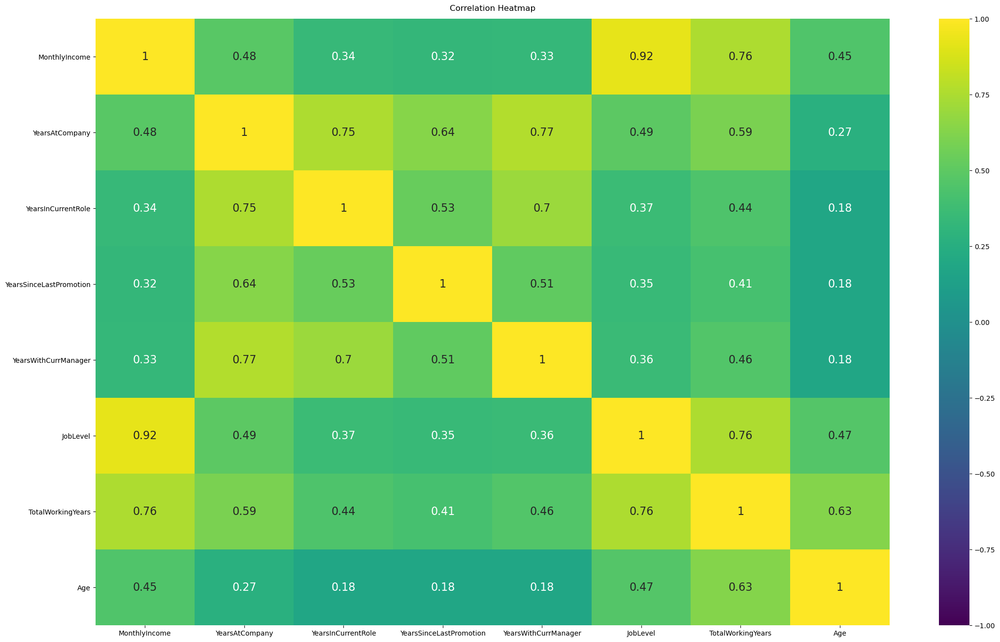

In [17]:
plt.figure(figsize=(26, 16))
columns = ['MonthlyIncome', 'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion', 'YearsWithCurrManager',
          'JobLevel', 'TotalWorkingYears', 'Age' ]
heatmap = sns.heatmap(df[columns].corr(), vmin=-1, vmax=1, cmap="viridis", annot=True, annot_kws={"size": 16} )
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize': 12}, pad=12)
plt.show()


Imputation of miising values using Naive Bayes.

In [18]:
imputer = IterativeImputer(estimator=BayesianRidge())

predictor_jl = ["JobLevel"]
target_mi = ["MonthlyIncome"]

imputing = imputer.fit_transform(df[predictor_jl + target_mi])

df[target_mi] = imputing[:, len(predictor_jl):]  

In [19]:
imputer = IterativeImputer(estimator=BayesianRidge())

predictor_mi = ["MonthlyIncome"]
target_jl = ["JobLevel"]

imputed_data = imputer.fit_transform(df[predictor_mi + target_jl])

df[target_jl] = imputed_data[:, len(predictor_mi):] 

In [20]:
imputer = IterativeImputer(estimator=BayesianRidge())

predictor_yac = ["YearsAtCompany"]
target_ywcm = ["YearsWithCurrManager"]

imputing = imputer.fit_transform(df[predictor_yac + target_ywcm])

df[target_ywcm] = imputing[:, len(predictor_yac):]  

In [21]:
imputer = IterativeImputer(estimator=BayesianRidge())

predictor_ywcm = ["YearsWithCurrManager"]
target_yat = ["YearsAtCompany"]

imputing = imputer.fit_transform(df[predictor_ywcm + target_yat])

df[target_yat] = imputing[:, len(predictor_ywcm):]  

In [22]:
imputer = IterativeImputer(estimator=BayesianRidge())

predictor_mi = ["MonthlyIncome"]
target_twy = ["TotalWorkingYears"]

imputing = imputer.fit_transform(df[predictor_mi + target_twy])

df[target_twy] = imputing[:, len(predictor_mi):]  

In [23]:
imputer = IterativeImputer(estimator=BayesianRidge())

predictor_yat = ["YearsAtCompany"]
target_yslp = ["YearsSinceLastPromotion"]

imputing = imputer.fit_transform(df[predictor_yat + target_yslp])

df[target_yslp] = imputing[:, len(predictor_yat):]  

In [24]:
imputer = IterativeImputer(estimator=BayesianRidge())

predictor_twy = ["TotalWorkingYears"]
target_age = ["Age"]

imputing = imputer.fit_transform(df[predictor_twy + target_age])

df[target_age] = imputing[:, len(predictor_twy):] 

In [25]:
imputer = IterativeImputer(estimator=BayesianRidge())

predictor_yac = ["YearsAtCompany"]
target_yicr = ["YearsInCurrentRole"]

imputing = imputer.fit_transform(df[predictor_yac + target_yicr])

df[target_yicr] = imputing[:, len(predictor_yac):]  

In [26]:
imputer = IterativeImputer(estimator=BayesianRidge())

predictor_a = ["Age"]
target_ncw = ["NumCompaniesWorked"]

imputing = imputer.fit_transform(df[predictor_a + target_ncw])

df[target_ncw] = imputing[:, len(predictor_a):]  

Creating relplot of "PerformanceRating" corelation with "PercentSalaryHike" before missing values were filled.

Text(0.5, 0.98, 'Relplot with missing values')

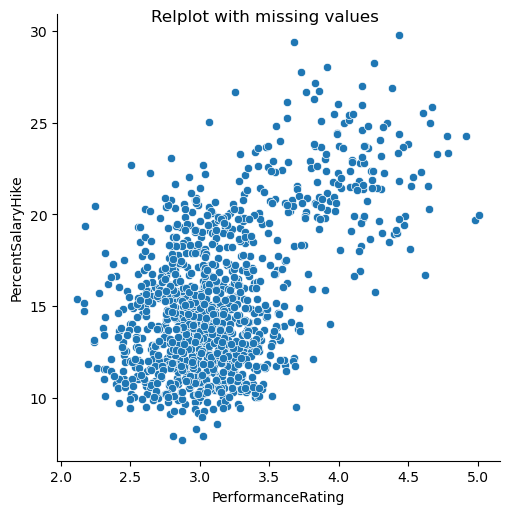

In [27]:
relplot = sns.relplot(x="PerformanceRating", y="PercentSalaryHike", data=df_mv)
relplot.fig.suptitle("Relplot with missing values")

In [28]:
imputer = IterativeImputer(estimator=BayesianRidge())

predictor_pr = ["PerformanceRating"]
target_psh = ["PercentSalaryHike"]

imputing = imputer.fit_transform(df[predictor_pr + target_psh])

df[target_psh] = imputing[:, len(predictor_pr):]  

In [29]:
imputer = IterativeImputer(estimator=BayesianRidge())

predictor_psh = ["PercentSalaryHike"]
target_pr = ["PerformanceRating"]

imputing = imputer.fit_transform(df[predictor_psh + target_pr])

df[target_pr] = imputing[:, len(predictor_psh):]  

Creating relplot of "PerformanceRating" corelation with "PercentSalaryHike" after missing values were filled.

Text(0.5, 0.98, 'Relplot with missing values filled')

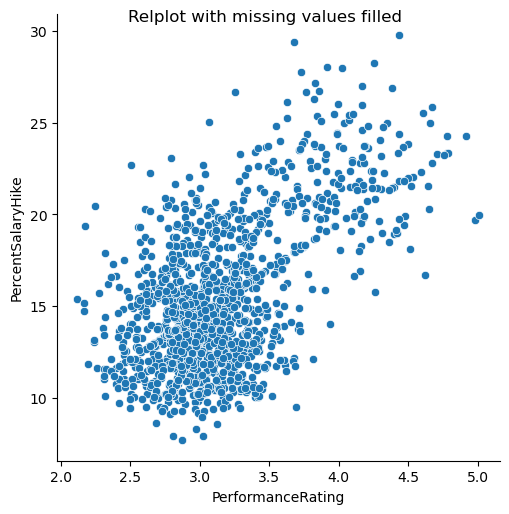

In [30]:
relplot1 = sns.relplot(x="PerformanceRating", y="PercentSalaryHike", data=df)
relplot1.fig.suptitle("Relplot with missing values filled")

In [31]:
imputer = IterativeImputer(estimator=BayesianRidge())

predictor_age = ["Age"]
target_e = ["Education"]

imputing = imputer.fit_transform(df[predictor_psh + target_e])

df[target_e] = imputing[:, len(predictor_age):]  

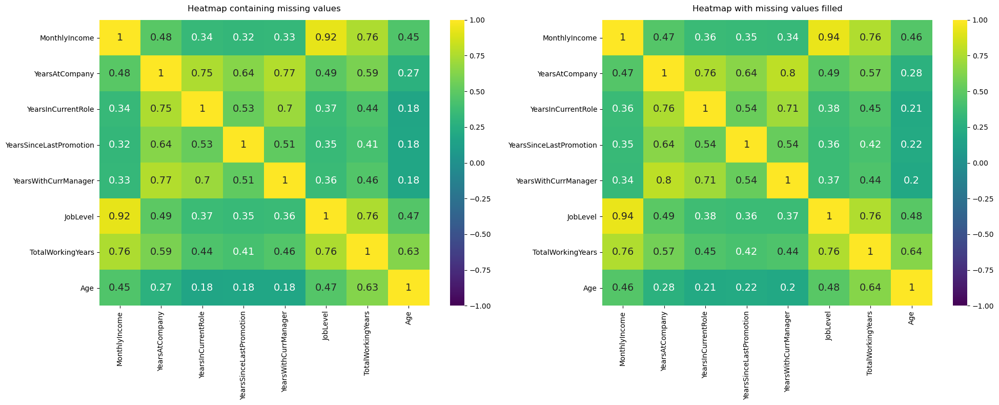

In [32]:
plt.figure(figsize=(20, 8))

plt.subplot(1, 2, 1)
columns = ["MonthlyIncome", "YearsAtCompany", "YearsInCurrentRole", "YearsSinceLastPromotion", "YearsWithCurrManager",
          "JobLevel", "TotalWorkingYears", "Age"]
heatmap = sns.heatmap(df_mv[columns].corr(), vmin=-1, vmax=1, cmap="viridis", annot=True, annot_kws={"size": 14})
heatmap.set_title("Heatmap containing missing values", fontdict={'fontsize': 12}, pad=12)

plt.subplot(1, 2, 2)
heatmap1 = sns.heatmap(df[columns].corr(), vmin=-1, vmax=1, cmap="viridis", annot=True, annot_kws={"size": 14})
heatmap1.set_title("Heatmap with missing values filled", fontdict={'fontsize': 12}, pad=12)

plt.tight_layout()
plt.show()

Analysing "EmployeeCount" to make the desicion to what method for imputing missing values to use.

In [33]:
df["EmployeeCount"].describe()

count        1323
mean     0.999325
std     0.0996565
min      0.628985
25%      0.931146
50%      0.998949
75%       1.06737
max       1.29061
Name: EmployeeCount, dtype: float64

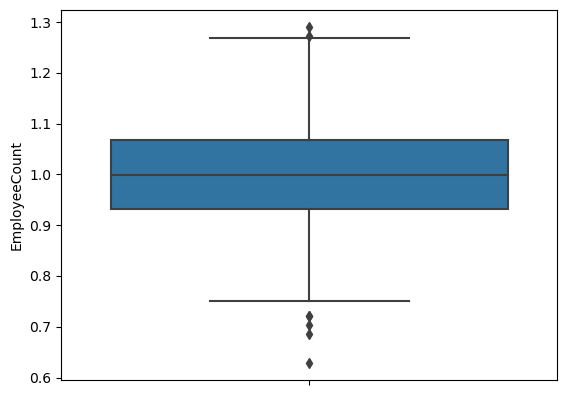

In [34]:
sns.boxplot(y="EmployeeCount", data=df);

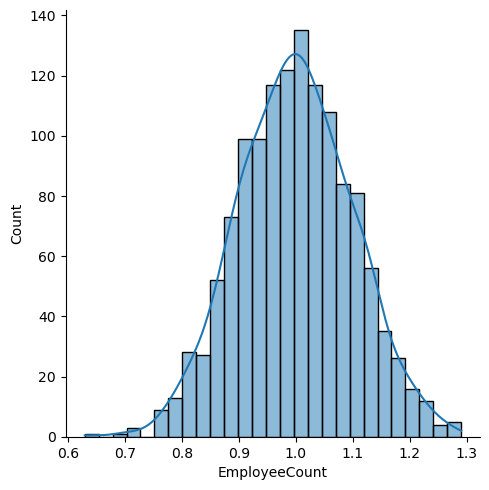

In [35]:
sns.displot(df["EmployeeCount"], kde = True);

In [36]:
Q1 = df["EmployeeCount"].quantile(0.25)
Q3 = df["EmployeeCount"].quantile(0.75)
IQR = Q3 - Q1
outliers = df[(df["EmployeeCount"] < (Q1 - 1.5 * IQR)) | (df["EmployeeCount"] > (Q3 + 1.5 * IQR))]
all_outliers = outliers.shape[0]
print("Total number of outliers:", all_outliers)

Total number of outliers: 7


Imputing missing values using "pad" method.

In [37]:
df['EmployeeCount'].fillna(method='pad', inplace=True)

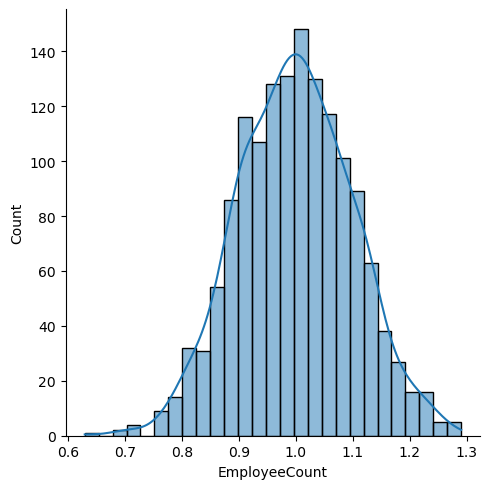

In [38]:
sns.displot(df["EmployeeCount"], kde = True);

In [39]:
df["EmployeeCount"].fillna(df["EmployeeCount"].median())

0        1.0333
1      0.944859
2      0.810809
3      0.822976
4      0.822976
         ...   
1465   0.950166
1466    1.06456
1467   0.960908
1468   0.873312
1469    1.06113
Name: EmployeeCount, Length: 1470, dtype: float64

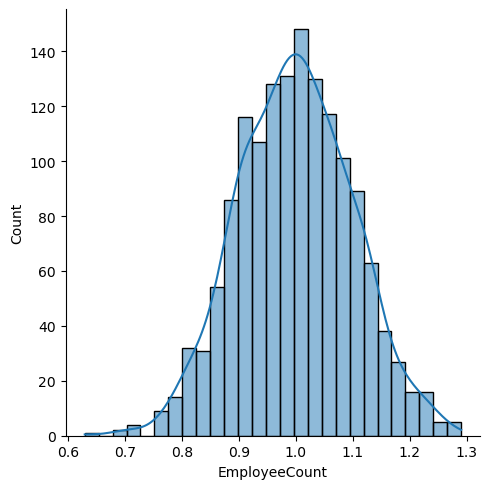

In [40]:
sns.displot(df["EmployeeCount"], kde = True);

Shape of the data hasn't changed after imputation.

In [41]:
df["StandardHours"].fillna(method="pad", inplace=True)

Checking distributions of all continous variables.

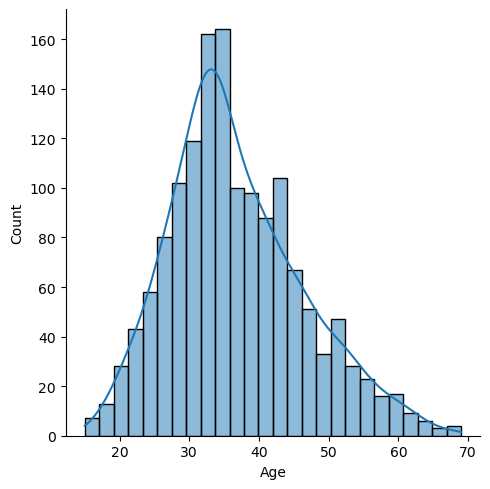

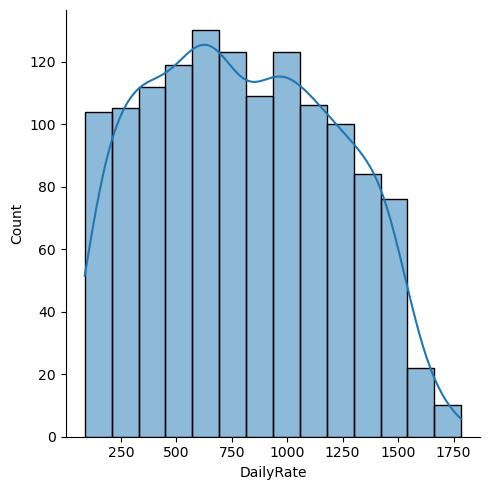

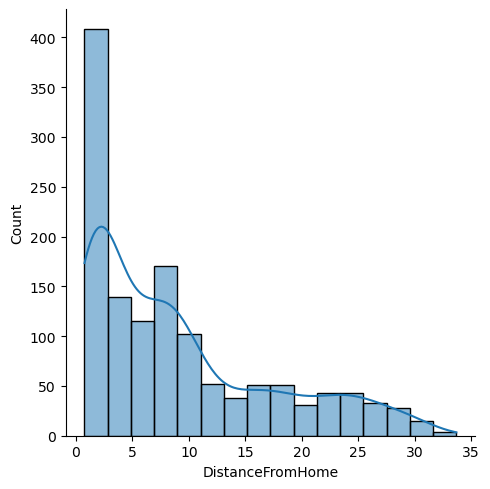

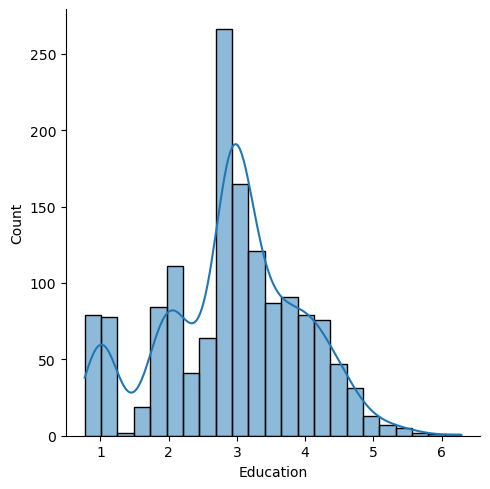

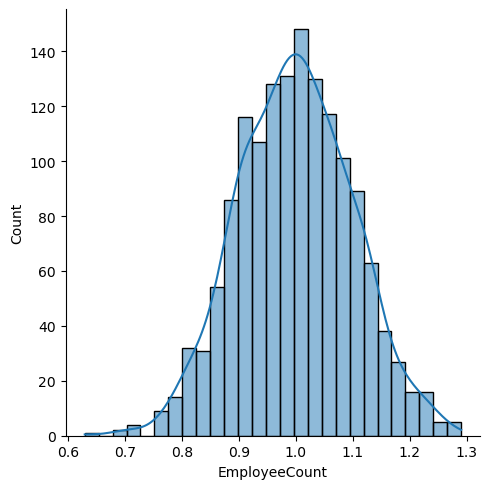

...

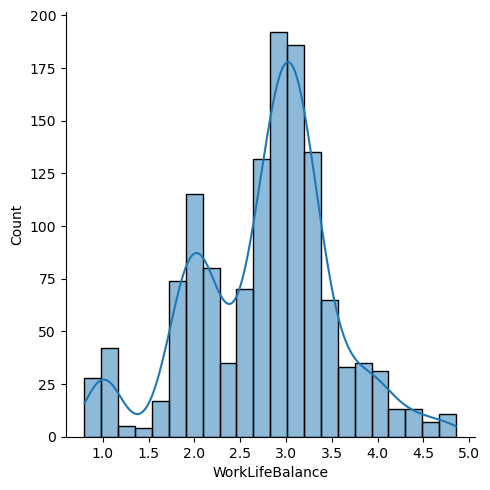

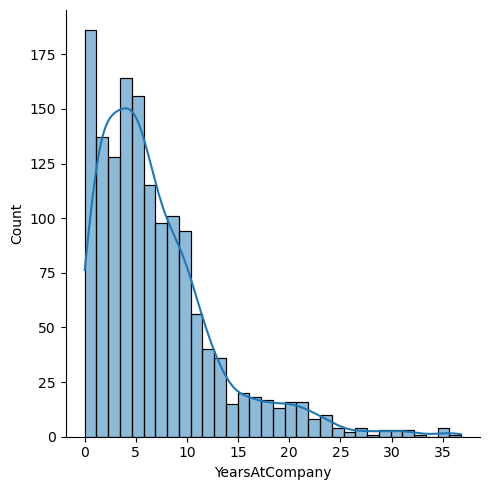

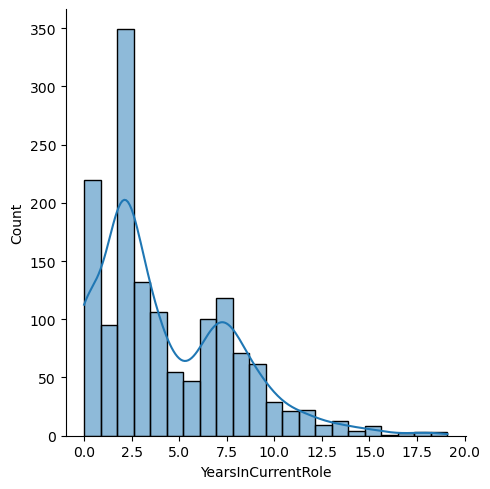

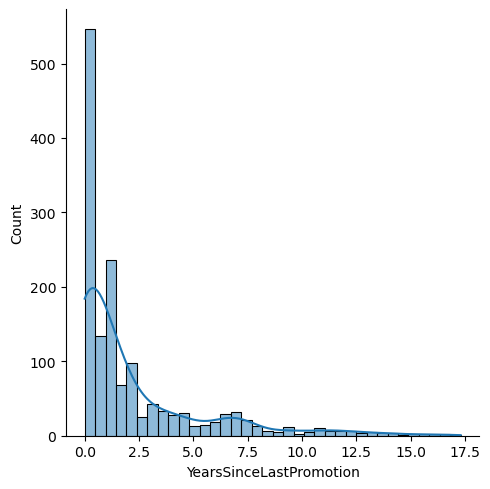

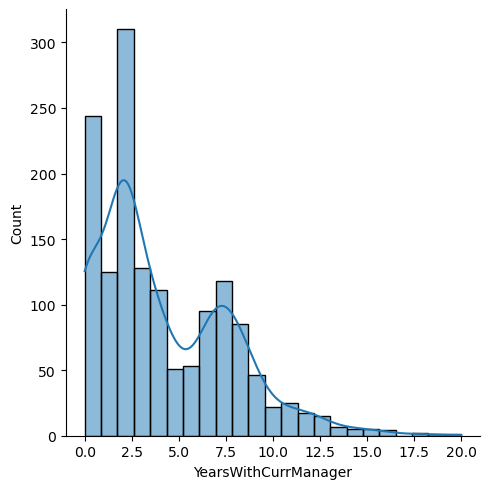

In [42]:
cont_var = df.select_dtypes(include="number").columns

for col in cont_var:
    sns.displot(df[col], kde=True)


4 variables were imputed using interpopations "linear" method.

In [43]:
df["DailyRate"].interpolate(method="linear", direction = "forward", inplace=True)
df["MonthlyRate"].interpolate(method="linear", direction = "forward", inplace=True)
df["HourlyRate"].interpolate(method="linear", direction = "forward", inplace=True)
df["DistanceFromHome"].interpolate(method="linear", direction = "forward", inplace=True)

The last remaining continous variables were imputed using interpolations "spline" method.

In [44]:
df["EnvironmentSatisfaction"].interpolate(method="spline", order=3, inplace=True)
df["JobInvolvement"].interpolate(method="spline", order=3, inplace=True)
df["JobSatisfaction"].interpolate(method="spline", order=3, inplace=True)
df["RelationshipSatisfaction"].interpolate(method="spline", order=3, inplace=True)
df["WorkLifeBalance"].interpolate(method="spline", order=3, inplace=True)
df["TrainingTimesLastYear"].interpolate(method="spline", order=3, inplace=True)
df["StockOptionLevel"].interpolate(method="spline", order=3, inplace=True)

Getting the piecharts of the categorical variables. This is needed to fill in missing values so the overall balance is right.

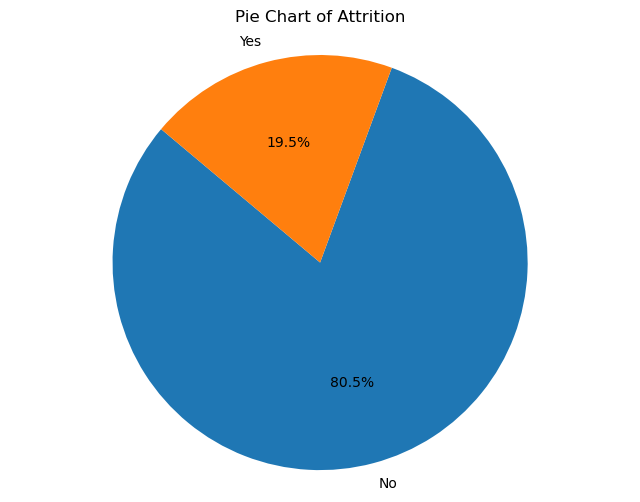

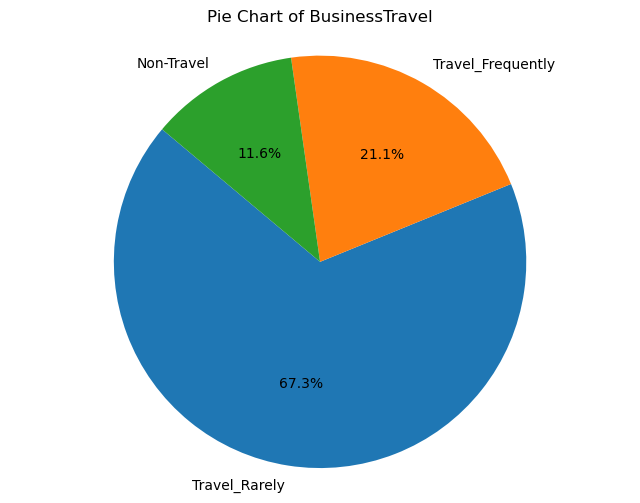

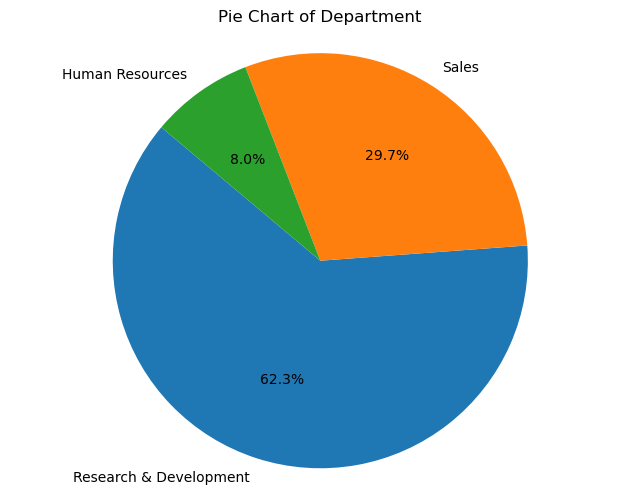

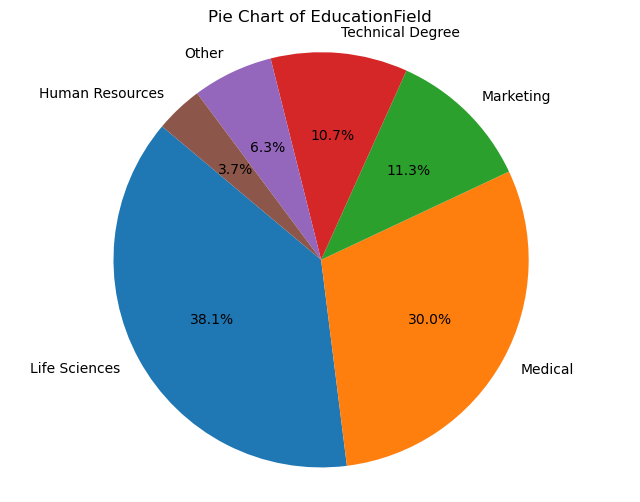

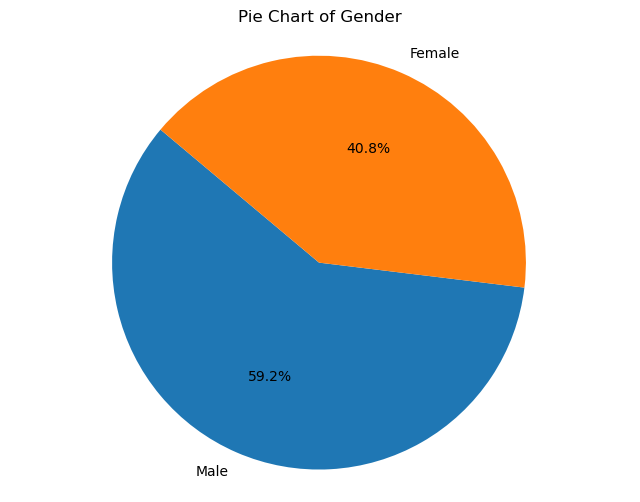

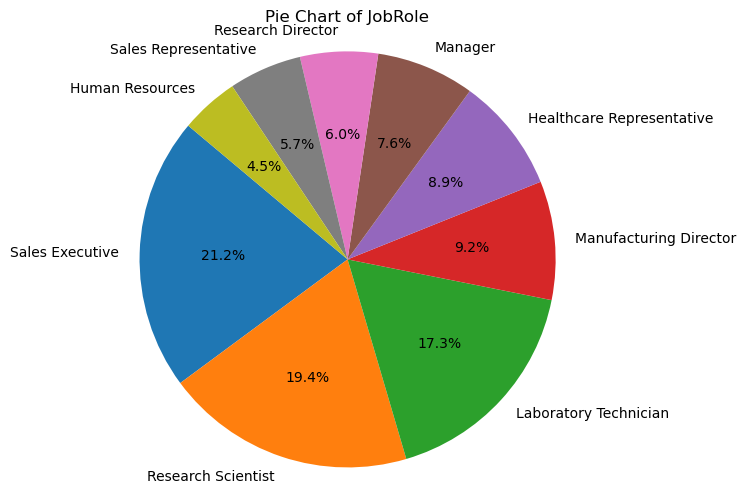

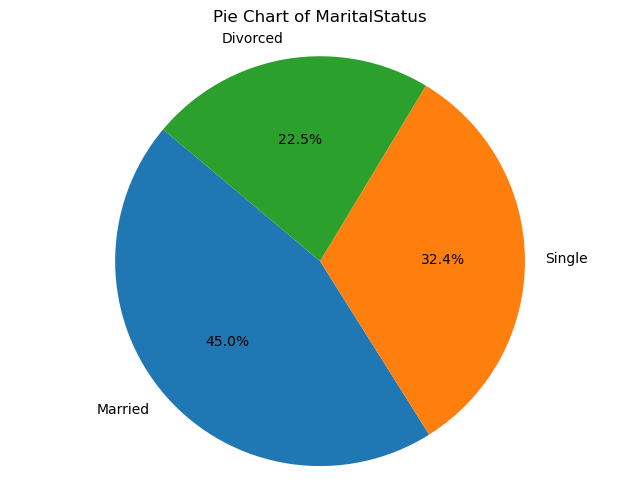

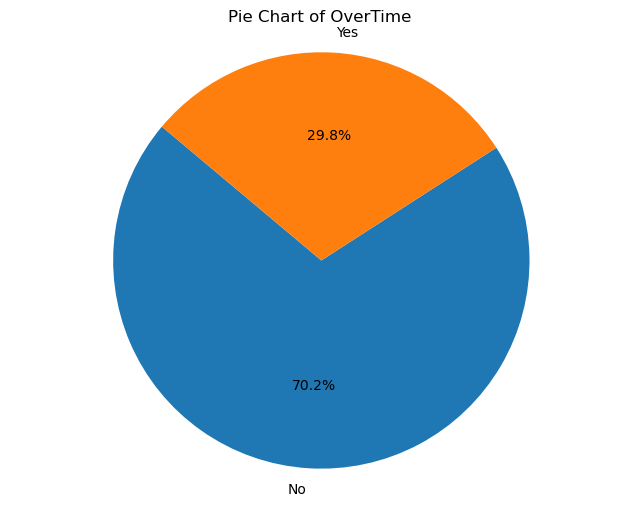

In [45]:
cat_var = df.select_dtypes(include="object").columns

for col in cat_var:
    category_counts = df[col].value_counts()
    
    plt.figure(figsize=(8, 6))
    plt.pie(category_counts, labels=category_counts.index, autopct='%1.1f%%', startangle=140)
    plt.title(f"Pie Chart of {col}")
    plt.axis("equal")  
    plt.show()

In [46]:
counts = {
    "Travel_Frequently": int(147 * 0.21),
    "Non-Travel": int(147 * 0.12),
    "Travel_Rarely": int(147 * 0.67)
}
for travel_freequency, count in counts.items():
    df['BusinessTravel'].fillna(travel_freequency, limit=count, inplace=True)


In [47]:
counts = {
    "Research & Development": int(147 * 0.62),
    "Sales": int(147 * 0.30),
    "Human Resources": int(147 * 0.08)
}
for department, count in counts.items():
    df["Department"].fillna(department, limit=count, inplace=True)

In [48]:
counts = {
    "Yes": int(147 * 0.2),
    "No": int(147 * 0.80),
}
for attrition, count in counts.items():
    df["Attrition"].fillna(attrition, limit=count, inplace=True)

In [49]:
counts = {
    "Married": int(147 * 0.45),
    "Single": int(147 * 0.32),
    "Divorced": int(147 * 0.23)
}
for marital, count in counts.items():
    df["MaritalStatus"].fillna(marital, limit=count, inplace=True)

In [50]:
counts = {
    "Male": int(147 * 0.6),
    "Female": int(147 * 0.40),
}
for gender, count in counts.items():
    df["Gender"].fillna(gender, limit=count, inplace=True)

In [51]:
counts = {
    "Yes": int(147 * 0.3),
    "No": int(147 * 0.7),
}
for overtime, count in counts.items():
    df["OverTime"].fillna(overtime, limit=count, inplace=True)

Two categorical variables have more than 2 or 3 values. To impute these variables new value "Unknown" is created.

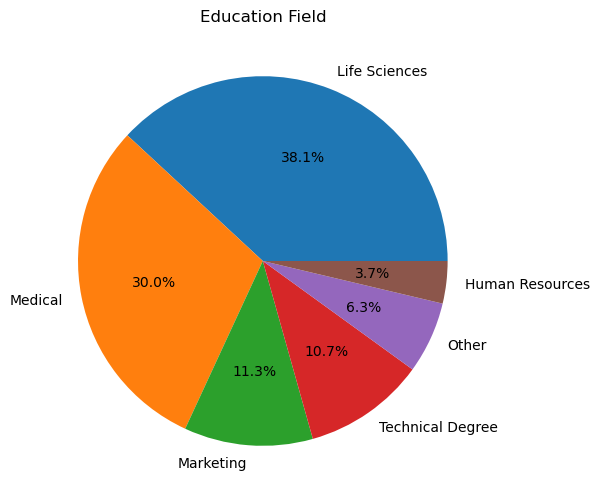

In [52]:
classes = df["EducationField"].value_counts()
plt.figure(figsize=(6, 6))  
plt.pie(classes, labels=classes.index, autopct='%1.1f%%')
plt.title("Education Field")
plt.show()

In [53]:
df["EducationField"].fillna("Unknown", inplace=True)

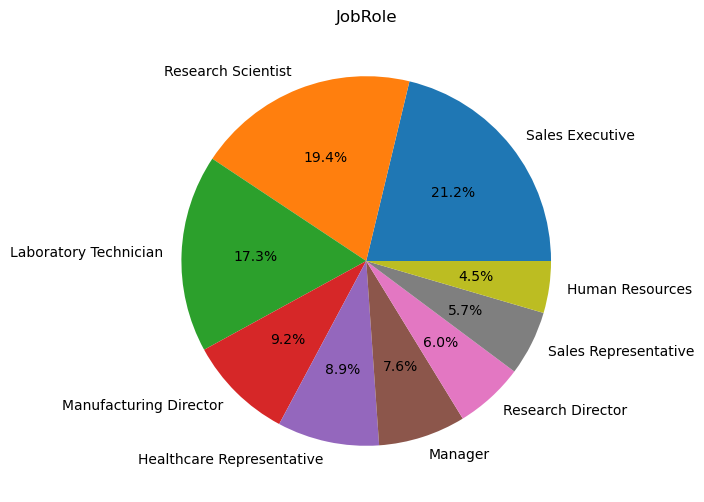

In [54]:
classes = df["JobRole"].value_counts()
plt.figure(figsize=(6, 6))  
plt.pie(classes, labels=classes.index, autopct='%1.1f%%')
plt.title("JobRole")
plt.show()

In [55]:
df["JobRole"].fillna("Unknown", inplace=True)

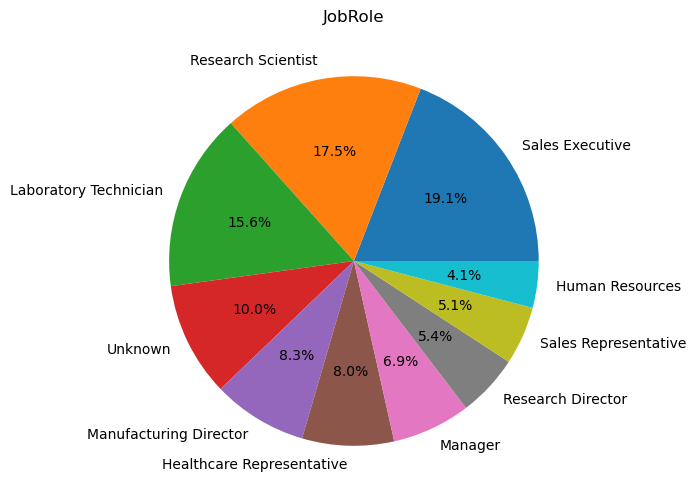

In [56]:
classes = df["JobRole"].value_counts()
plt.figure(figsize=(6, 6))  
plt.pie(classes, labels=classes.index, autopct='%1.1f%%')
plt.title("JobRole")
plt.show()

Checking the dataset for the last remaining missing values.

In [57]:
df.isnull().sum()

Age                         0
Attrition                   1
BusinessTravel              2
DailyRate                   0
Department                  1
DistanceFromHome            0
Education                   0
EducationField              0
EmployeeCount               0
EnvironmentSatisfaction     0
Gender                      1
HourlyRate                  0
JobInvolvement              0
JobLevel                    0
JobRole                     0
JobSatisfaction             0
MaritalStatus               1
MonthlyIncome               0
MonthlyRate                 0
NumCompaniesWorked          0
OverTime                    1
PercentSalaryHike           0
PerformanceRating           0
RelationshipSatisfaction    0
StandardHours               0
StockOptionLevel            0
TotalWorkingYears           0
TrainingTimesLastYear       0
WorkLifeBalance             0
YearsAtCompany              0
YearsInCurrentRole          0
YearsSinceLastPromotion     0
YearsWithCurrManager        0
dtype: int

Filling in the remaining missing values with mode values.

In [58]:
for column in df.columns:
    df[column].fillna(df[column].mode()[0], inplace=True)

In [59]:
df.isnull().sum()

Age                         0
Attrition                   0
BusinessTravel              0
DailyRate                   0
Department                  0
DistanceFromHome            0
Education                   0
EducationField              0
EmployeeCount               0
EnvironmentSatisfaction     0
Gender                      0
HourlyRate                  0
JobInvolvement              0
JobLevel                    0
JobRole                     0
JobSatisfaction             0
MaritalStatus               0
MonthlyIncome               0
MonthlyRate                 0
NumCompaniesWorked          0
OverTime                    0
PercentSalaryHike           0
PerformanceRating           0
RelationshipSatisfaction    0
StandardHours               0
StockOptionLevel            0
TotalWorkingYears           0
TrainingTimesLastYear       0
WorkLifeBalance             0
YearsAtCompany              0
YearsInCurrentRole          0
YearsSinceLastPromotion     0
YearsWithCurrManager        0
dtype: int

This confirms all missing data is now filled in.

<span style="color: blue;">

### 2.3. Feature Engineering <a class="anchor" id="tenth-bullet"></a>
    
</span>

### Encoding

Choosing target variable for mashine learning algorithms and encoding it to give numerical values.

In [60]:
df["Attrition"] = df["Attrition"].replace({"Yes": 1, "No": 0})

Encoding the rest of the dataset using dummy encoding.

In [61]:
df_encoded = pd.get_dummies(data=df,drop_first=True)
df_encoded

,Age,Attrition,DailyRate,DistanceFromHome,Education,EmployeeCount,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,JobSatisfaction,MonthlyIncome,MonthlyRate,NumCompaniesWorked,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,BusinessTravel_Travel_Frequently,BusinessTravel_Travel_Rarely,Department_Research & Development,Department_Sales,EducationField_Life Sciences,EducationField_Marketing,EducationField_Medical,EducationField_Other,EducationField_Technical Degree,EducationField_Unknown,Gender_Male,JobRole_Human Resources,JobRole_Laboratory Technician,JobRole_Manager,JobRole_Manufacturing Director,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative,JobRole_Unknown,MaritalStatus_Married,MaritalStatus_Single,OverTime_Yes
0,42,1,990.11,1.02,1.77031,1.0333,2.14629,93.83,3.42696,2.46449,3.39767,6438.95,20845.1,7,9.89877,2.8449,1.01283,95.6,0,8.1,0,1.0521,5.8,4,0,4.6,0,1,0,1,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,1
1,52,0,276.78,1.61,1.03533,0.944859,3.4708,52.3,1.81346,1.7887,1.58406,4457.66,24877.9,1,20.1189,4.12028,4.31201,85.4,1.10464,9,3,2.52647,10.1,7.9,1,5.9,1,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0
2,33,1,1204.16,2.2,2.1188,0.810809,3.97942,87.27,1.87723,0.833488,3.30101,2124.55,2262.94,6,15.4016,2.78117,2.33256,76.2,0,8.4,3,2.92478,0,0,0,0,0,1,1,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,1,1
3,35,0,1352.75,2.94,3.67067,0.822976,3.7347,56.38,2.93265,1.09537,3.22084,2771.7,27189.9,1,9.75755,2.76958,3.02959,75.9,0,7.7,3,3.11705,8.4,5.6,2.8,0,1,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1
4,25,0,485.05,1.99,1.1205,0.822976,1.07941,40.43,3.11774,0.937746,1.69733,3254.6,17675.5,10,11.9201,3.28218,2.77663,72.7,0.953012,6.2,3,3.11232,2,2,2.5,2.2,0,1,1,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1465,37,0,914.06,21.65,2.92085,0.950166,3.17144,33.245,3.37268,1.99384,4.16923,2806.95,13077.1,4,17.9152,2.96856,3.02018,85.8,0.962354,6.70633,3,2.81934,5.4,2,0,3.37358,1,0,1,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0
1466,35,0,574.68,6.03,1.12296,1.06456,4.28409,39.84,2.03873,2.53248,3.14489,8398.37,21026.2,2.53734,14.6923,2.80089,1.01469,94.9,0.923291,13.7814,5,2.56063,7.4,7.5,0.9,6.8,0,1,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0
1467,27,0,151.51,4.06,3.47889,0.960908,2.15228,91.6,4.39486,1.96461,2.15204,6609.84,16432,1,18.7444,3.38408,1.95208,93.3,1.09656,6.3,0,2.58712,6,1.8,0,3.3,0,1,1,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,1,0,1
1468,39.7035,0,995.98,2.09,2.95609,0.873312,4.09558,59.11,2.01976,1.92503,2.25764,5585.3,11837.9,2,12.9304,3.2214,4.1821,83.9,0,15.2,3,1.98977,7.7,6.6,0,4.47007,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0


In [62]:
df_encoded.shape

(1470, 49)

### Scaling

Importing libraries for scaling.

In [63]:
from sklearn import preprocessing
from sklearn.preprocessing import MinMaxScaler
import sklearn.preprocessing as preproc

These two variables are close to normal distribution and are scaled using StandardScaler

In [64]:
df_encoded["DailyRate"]= preproc.StandardScaler().fit_transform(df_encoded[["DailyRate"]])
df_encoded["MonthlyRate"]= preproc.StandardScaler().fit_transform(df_encoded[["MonthlyRate"]])

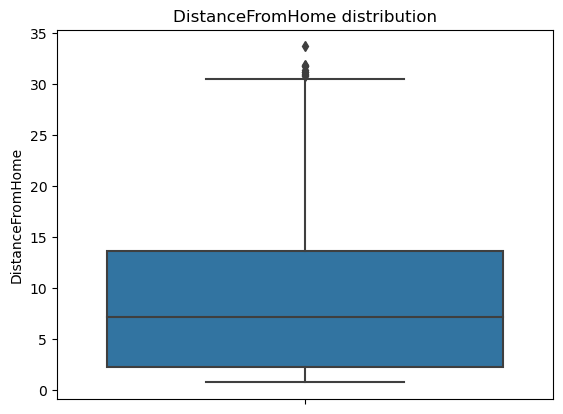

In [65]:
plot = sns.boxplot(y="DistanceFromHome", data=df)
plt.title("DistanceFromHome distribution")
plt.show()

In [66]:
df["DistanceFromHome"].describe()

count      1470
mean    9.16383
std     8.00184
min        0.75
25%        2.22
50%       7.185
75%     13.5875
max       33.68
Name: DistanceFromHome, dtype: float64

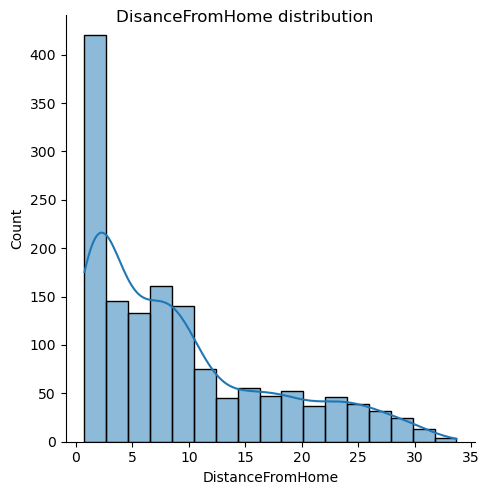

In [67]:
plot = sns.displot(df["DistanceFromHome"], kde = True)
plot.fig.suptitle("DisanceFromHome distribution");

In [68]:
df["DistanceFromHome"].skew()

1.0043935148639542

Three variables with the largest standard deviations are scaled using MinMax scaler.

In [69]:
df_encoded["DistanceFromHome"]=preproc.minmax_scale(df_encoded[["DistanceFromHome"]])
df_encoded["MonthlyIncome"]=preproc.minmax_scale(df_encoded[["MonthlyIncome"]])
df_encoded["YearsInCurrentRole"]=preproc.minmax_scale(df_encoded[["YearsInCurrentRole"]])

In [70]:
df_encoded.head()

,Age,Attrition,DailyRate,DistanceFromHome,Education,EmployeeCount,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,JobSatisfaction,MonthlyIncome,MonthlyRate,NumCompaniesWorked,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,BusinessTravel_Travel_Frequently,BusinessTravel_Travel_Rarely,Department_Research & Development,Department_Sales,EducationField_Life Sciences,EducationField_Marketing,EducationField_Medical,EducationField_Other,EducationField_Technical Degree,EducationField_Unknown,Gender_Male,JobRole_Human Resources,JobRole_Laboratory Technician,JobRole_Manager,JobRole_Manufacturing Director,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative,JobRole_Unknown,MaritalStatus_Married,MaritalStatus_Single,OverTime_Yes
0,42,1,0.45963,0.00819921,1.77031,1.0333,2.14629,93.83,3.42696,2.46449,3.39767,0.252542,0.916753,7,9.89877,2.8449,1.01283,95.6,0,8.1,0,1.0521,5.8,0.209424,0,4.6,0,1,0,1,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,1
1,52,0,-1.31218,0.026116,1.03533,0.944859,3.4708,52.3,1.81346,1.7887,1.58406,0.162346,1.48597,1,20.1189,4.12028,4.31201,85.4,1.10464,9,3,2.52647,10.1,0.413613,1,5.9,1,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0
2,33,1,0.991299,0.0440328,2.1188,0.810809,3.97942,87.27,1.87723,0.833488,3.30101,0.056134,-1.70605,6,15.4016,2.78117,2.33256,76.2,0,8.4,3,2.92478,0,0,0,0,0,1,1,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,1,1
3,35,0,1.36038,0.0665047,3.67067,0.822976,3.7347,56.38,2.93265,1.09537,3.22084,0.0855947,1.8123,1,9.75755,2.76958,3.02959,75.9,0,7.7,3,3.11705,8.4,0.293194,2.8,0,1,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1
4,25,0,-0.794865,0.0376556,1.1205,0.822976,1.07941,40.43,3.11774,0.937746,1.69733,0.107578,0.469381,10,11.9201,3.28218,2.77663,72.7,0.953012,6.2,3,3.11232,2,0.104712,2.5,2.2,0,1,1,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,1


<span style="color: blue;">

### 2.4. Dimensionality Reduction <a class="anchor" id="eleventh-bullet"></a>
    
</span>

<span style="color: blue;">

#### 2.4.1. Principal Component Analysis (PCA) <a class="anchor" id="21th-bullet"></a>
    
</span>  

Checking the total amount of variables before running PCA.

In [71]:
df_encoded.shape

(1470, 49)

Importing library to perform PCA.

In [72]:
from sklearn.decomposition import PCA

In [73]:
pca = PCA()
fit = pca.fit_transform(df_encoded)

Examining the eigenvectors.

In [74]:
pca.explained_variance_

array([4.40635594e+02, 1.40376668e+02, 6.45234754e+01, 4.59190941e+01,
       1.74723098e+01, 1.48900893e+01, 5.33505645e+00, 4.68486743e+00,
       3.42072261e+00, 1.67129859e+00, 1.24311214e+00, 1.17170963e+00,
       1.12387538e+00, 1.05455113e+00, 9.94728145e-01, 9.34930531e-01,
       7.34479325e-01, 6.21099812e-01, 5.21101691e-01, 5.05596451e-01,
       4.39962199e-01, 3.39933472e-01, 3.21822456e-01, 2.85459402e-01,
       2.40236885e-01, 2.16560102e-01, 1.64323129e-01, 1.61351912e-01,
       1.38675164e-01, 1.31471402e-01, 1.18707122e-01, 9.85857339e-02,
       9.53415640e-02, 8.67477580e-02, 8.25796692e-02, 7.05615052e-02,
       6.21626155e-02, 5.92838675e-02, 5.67470231e-02, 5.34706787e-02,
       4.89324417e-02, 4.61346121e-02, 3.19666713e-02, 2.15096072e-02,
       1.32217736e-02, 9.83947593e-03, 7.39923046e-03, 4.60718835e-03,
       4.29121830e-03])

Examining the proportion of the variance in the data each principal component explains.

In [75]:
pca.explained_variance_ratio_

array([5.86539495e-01, 1.86858396e-01, 8.58885828e-02, 6.11238916e-02,
       2.32577666e-02, 1.98205174e-02, 7.10160813e-03, 6.23612757e-03,
       4.55339728e-03, 2.22470142e-03, 1.65473325e-03, 1.55968783e-03,
       1.49601464e-03, 1.40373564e-03, 1.32410398e-03, 1.24450609e-03,
       9.77681192e-04, 8.26759289e-04, 6.93649644e-04, 6.73010286e-04,
       5.85643125e-04, 4.52492739e-04, 4.28384777e-04, 3.79981137e-04,
       3.19784473e-04, 2.88267799e-04, 2.18734044e-04, 2.14778992e-04,
       1.84593487e-04, 1.75004405e-04, 1.58013598e-04, 1.31229586e-04,
       1.26911202e-04, 1.15471802e-04, 1.09923570e-04, 9.39259338e-05,
       8.27459916e-05, 7.89140283e-05, 7.55371803e-05, 7.11759679e-05,
       6.51350233e-05, 6.14107722e-05, 4.25515222e-05, 2.86318997e-05,
       1.75997866e-05, 1.30975376e-05, 9.84927446e-06, 6.13272729e-06,
       5.71213277e-06])

In [76]:
pca.n_components_

49

Finding out how many principal components are needed to retain 99.5% of variance.

In [77]:
pca2 = PCA(.995)
fit = pca2.fit_transform(df_encoded)
pca2.explained_variance_

array([440.63559365, 140.37666842,  64.52347543,  45.91909409,
        17.47230985,  14.89008932,   5.33505645,   4.68486743,
         3.42072261,   1.67129859,   1.24311214,   1.17170963,
         1.12387538,   1.05455113,   0.99472815,   0.93493053,
         0.73447933,   0.62109981,   0.52110169,   0.50559645])

In [78]:
pca2.explained_variance_ratio_

array([0.58653949, 0.1868584 , 0.08588858, 0.06112389, 0.02325777,
       0.01982052, 0.00710161, 0.00623613, 0.0045534 , 0.0022247 ,
       0.00165473, 0.00155969, 0.00149601, 0.00140374, 0.0013241 ,
       0.00124451, 0.00097768, 0.00082676, 0.00069365, 0.00067301])

In [79]:
explained_variance = pca2.explained_variance_ratio_

cumulative_variance = np.cumsum(explained_variance)

threshold = 0.995

num_components_to_retain = np.argmax(cumulative_variance >= threshold) + 1

print(f"Number of components to retain for {threshold * 100}% of variance: {num_components_to_retain}")

Number of components to retain for 99.5% of variance: 20


Plotting the scree plot.

Text(0, 0.5, 'Eigenvalue')

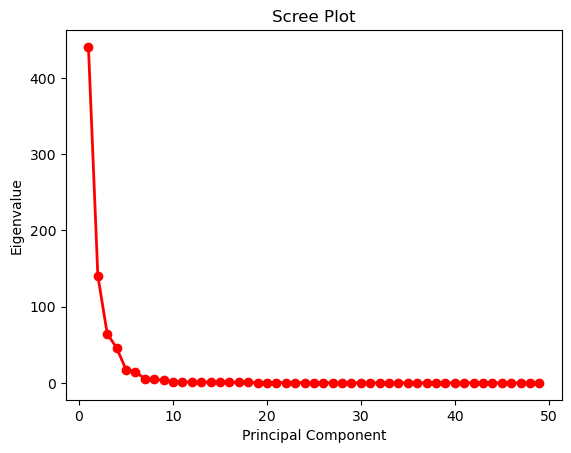

In [80]:
principal_component_number = np.arange(49) + 1
plt.plot(principal_component_number, pca.explained_variance_, 'ro-', linewidth=2)
plt.title('Scree Plot')
plt.xlabel('Principal Component')
plt.ylabel('Eigenvalue')

Calculating the number of component needed to retain 95% of variance.

In [81]:
pca3 = PCA(.95)
fit = pca3.fit_transform(df_encoded)
pca3.explained_variance_

array([440.63559365, 140.37666842,  64.52347543,  45.91909409,
        17.47230985,  14.89008932])

<span style="color: blue;">

#### 2.4.2. Linear Discriminant Analysis (LDA) <a class="anchor" id="22th-bullet"></a>
    
</span> 

In [82]:
X = df_encoded.drop("Attrition", axis=1) 
y = df_encoded["Attrition"] 

In [83]:
X.shape

(1470, 48)

In [84]:
X.head()

,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,JobSatisfaction,MonthlyIncome,MonthlyRate,NumCompaniesWorked,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,BusinessTravel_Travel_Frequently,BusinessTravel_Travel_Rarely,Department_Research & Development,Department_Sales,EducationField_Life Sciences,EducationField_Marketing,EducationField_Medical,EducationField_Other,EducationField_Technical Degree,EducationField_Unknown,Gender_Male,JobRole_Human Resources,JobRole_Laboratory Technician,JobRole_Manager,JobRole_Manufacturing Director,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative,JobRole_Unknown,MaritalStatus_Married,MaritalStatus_Single,OverTime_Yes
0,42,0.45963,0.00819921,1.77031,1.0333,2.14629,93.83,3.42696,2.46449,3.39767,0.252542,0.916753,7,9.89877,2.8449,1.01283,95.6,0,8.1,0,1.0521,5.8,0.209424,0,4.6,0,1,0,1,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,1
1,52,-1.31218,0.026116,1.03533,0.944859,3.4708,52.3,1.81346,1.7887,1.58406,0.162346,1.48597,1,20.1189,4.12028,4.31201,85.4,1.10464,9,3,2.52647,10.1,0.413613,1,5.9,1,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0
2,33,0.991299,0.0440328,2.1188,0.810809,3.97942,87.27,1.87723,0.833488,3.30101,0.056134,-1.70605,6,15.4016,2.78117,2.33256,76.2,0,8.4,3,2.92478,0,0,0,0,0,1,1,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,1,1
3,35,1.36038,0.0665047,3.67067,0.822976,3.7347,56.38,2.93265,1.09537,3.22084,0.0855947,1.8123,1,9.75755,2.76958,3.02959,75.9,0,7.7,3,3.11705,8.4,0.293194,2.8,0,1,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1
4,25,-0.794865,0.0376556,1.1205,0.822976,1.07941,40.43,3.11774,0.937746,1.69733,0.107578,0.469381,10,11.9201,3.28218,2.77663,72.7,0.953012,6.2,3,3.11232,2,0.104712,2.5,2.2,0,1,1,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,1


In [85]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
lda = LinearDiscriminantAnalysis()
X_lda = lda.fit_transform(X, y)

In [86]:
lda.explained_variance_ratio_

array([1.])

Result explains that only 1 component contains 100% of variance, and perfectly separates two classes.

Let's compare both analysis using Desicion Tree ML model.

In [87]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix

In [88]:
X_train, X_test, y_train, y_test = train_test_split(X_lda, y, test_size=0.2, random_state=42)

In [89]:
model = DecisionTreeClassifier() 
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

In [90]:
cm_dt_lda = confusion_matrix(y_test, y_pred)
accuracy_dt_lda = (cm_dt_lda[0, 0] + cm_dt_lda[1, 1]) / (cm_dt_lda[0, 0] + cm_dt_lda[1, 1] + cm_dt_lda[0, 1] + cm_dt_lda[1, 0])
print("Confusion Matrix using LDA:")
print(cm_dt_lda)
print("Accuracy is:", accuracy_dt_lda)

Confusion Matrix using LDA:
[[194  47]
 [ 36  17]]
Accuracy is: 0.717687074829932


In [91]:
pca2 = PCA(.995)
X_pca = pca2.fit_transform(df_encoded)

In [92]:
X_train, X_test, y_train, y_test = train_test_split(X_pca, y, test_size=0.2, random_state=42)

In [93]:
model = DecisionTreeClassifier() 
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

In [94]:
cm_dt_pca = confusion_matrix(y_test, y_pred)
accuracy_dt_pca = (cm_dt_pca[0, 0] + cm_dt_pca[1, 1]) / (cm_dt_pca[0, 0] + cm_dt_pca[1, 1] + cm_dt_pca[0, 1] + cm_dt_pca[1, 0])
print("Confusion Matrix using PCA:")
print(cm_dt_pca)
print("Accuracy is:", accuracy_dt_pca)

Confusion Matrix using PCA:
[[193  48]
 [ 42  11]]
Accuracy is: 0.6938775510204082


Comparison of LDA and PCA analysis's.

In [95]:
accuracy_list = [accuracy_dt_lda, accuracy_dt_pca]  
true_positives_list = [cm_dt_lda[0, 0], cm_dt_pca[0, 0]] 
false_positives_list = [cm_dt_lda[1, 0], cm_dt_pca[1, 0]]  
true_negatives_list = [cm_dt_lda[1, 1], cm_dt_pca[1, 1]]  
false_negatives_list = [cm_dt_lda[0, 1], cm_dt_pca[0, 1]] 
models = ["Desicion Tree using LDA", "Desicion Tree using PCA"]
subtable = pd.DataFrame({
    "Type of Analysis": models,
    "Accuracy": accuracy_list,
    "True Positive (Correct)": true_positives_list,
    "False Positive (Incorrect)": false_positives_list,
    "True Negative (Correct)": true_negatives_list,
    "False Negative (Incorrect)": false_negatives_list})
subtable.head()

,Type of Analysis,Accuracy,True Positive (Correct),False Positive (Incorrect),True Negative (Correct),False Negative (Incorrect)
0,Desicion Tree using LDA,0.717687,194,36,17,47
1,Desicion Tree using PCA,0.693878,193,42,11,48


In this case, LDA slightly outperformed PCA with the accuracy of 71.7% versus PCA‘s 70%.

<span style="color: blue;">

## 3. Statistical Techniques <a class="anchor" id="twelwth-bullet"></a>
    
</span>

<span style="color: blue;">

### 3.1. Descriptive Statistics <a class="anchor" id="12th-bullet"></a>
    
</span>

In this chapter dataset is statistically explored.

In [96]:
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,42,1,Travel_Rarely,990.11,Sales,1.02,1.77031,Life Sciences,1.0333,2.14629,Male,93.83,3.42696,2.46449,Sales Executive,3.39767,Single,6438.95,20845.1,7,Yes,9.89877,2.8449,1.01283,95.6,0,8.1,0,1.0521,5.8,4,0,4.6
1,52,0,Travel_Frequently,276.78,Research & Development,1.61,1.03533,Life Sciences,0.944859,3.4708,Male,52.3,1.81346,1.7887,Research Scientist,1.58406,Married,4457.66,24877.9,1,No,20.1189,4.12028,4.31201,85.4,1.10464,9,3,2.52647,10.1,7.9,1,5.9
2,33,1,Travel_Rarely,1204.16,Research & Development,2.2,2.1188,Other,0.810809,3.97942,Male,87.27,1.87723,0.833488,Laboratory Technician,3.30101,Single,2124.55,2262.94,6,Yes,15.4016,2.78117,2.33256,76.2,0,8.4,3,2.92478,0,0,0,0
3,35,0,Travel_Frequently,1352.75,Sales,2.94,3.67067,Life Sciences,0.822976,3.7347,Female,56.38,2.93265,1.09537,Research Scientist,3.22084,Married,2771.7,27189.9,1,Yes,9.75755,2.76958,3.02959,75.9,0,7.7,3,3.11705,8.4,5.6,2.8,0
4,25,0,Travel_Rarely,485.05,Research & Development,1.99,1.1205,Medical,0.822976,1.07941,Male,40.43,3.11774,0.937746,Laboratory Technician,1.69733,Married,3254.6,17675.5,10,Yes,11.9201,3.28218,2.77663,72.7,0.953012,6.2,3,3.11232,2,2,2.5,2.2


In [97]:
df.describe(include = "all")

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
count,1470,1470,1470,1470,1470,1470,1470,1470,1470,1470,1470,1470,1470,1470,1470,1470,1470,1470,1470,1470,1470,1470,1470,1470,1470,1470,1470,1470,1470,1470,1470,1470,1470
unique,NaN,NaN,3,NaN,3,NaN,NaN,7,NaN,NaN,2,NaN,NaN,NaN,10,NaN,3,NaN,NaN,NaN,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,NaN,NaN,Travel_Rarely,NaN,Research & Development,NaN,NaN,Life Sciences,NaN,NaN,Male,NaN,NaN,NaN,Sales Executive,NaN,Married,NaN,NaN,NaN,No,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,NaN,NaN,990,NaN,916,NaN,NaN,504,NaN,NaN,872,NaN,NaN,NaN,281,NaN,663,NaN,NaN,NaN,1032,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,36.7324,0.195238,NaN,805.063,NaN,9.16383,2.92341,NaN,0.999067,2.72414,NaN,65.5769,2.74281,2.05594,NaN,2.70797,NaN,6504.56,14350,2.66088,NaN,15.3235,3.14665,2.72116,80.2216,0.814654,11.3851,2.82295,2.7627,6.97423,4.2603,2.18354,4.12407
std,9.58216,0.396519,NaN,402.737,NaN,8.00184,1.01714,NaN,0.10015,1.08244,NaN,20.9834,0.726274,1.11026,NaN,1.10291,NaN,4715.85,7087.26,2.39341,NaN,3.86735,0.459092,1.0703,8.02268,0.818911,7.85747,1.2949,0.722742,5.92165,3.5914,3.1342,3.52652
min,15,0,NaN,86.83,NaN,0.75,0.770362,NaN,0.628985,0.759655,NaN,23.86,0.722008,0.715172,NaN,0.724192,NaN,891.48,1567.5,0,NaN,7.68472,2.11695,0.720696,53.8,0,0,0,0.799138,0,0,0,0
25%,30,0,NaN,474.305,NaN,2.22,2.20084,NaN,0.928546,1.93848,NaN,48.2625,2.26067,1.06093,NaN,1.89456,NaN,2905.61,8340.44,1,NaN,12.4372,2.86193,1.95765,74.825,0,6.15387,2,2.28843,2.8,1.9,0,1.70501
50%,35,0,NaN,794.892,NaN,7.185,2.9275,NaN,0.999009,2.85036,NaN,65.065,2.78518,1.9292,NaN,2.86228,NaN,5055.7,14289.5,2,NaN,14.6029,3.06987,2.87076,80.2,0.873921,9.30097,3,2.81124,5.5,3.1,1,3
75%,42.03,0,NaN,1119.24,NaN,13.5875,3.5982,NaN,1.06808,3.52154,NaN,82.59,3.13924,2.51587,NaN,3.57582,NaN,8246.63,19930.9,4,NaN,17.4653,3.32872,3.51309,85.6,1.05753,15.1,3,3.16952,9.4,6.9,2.8,6.8


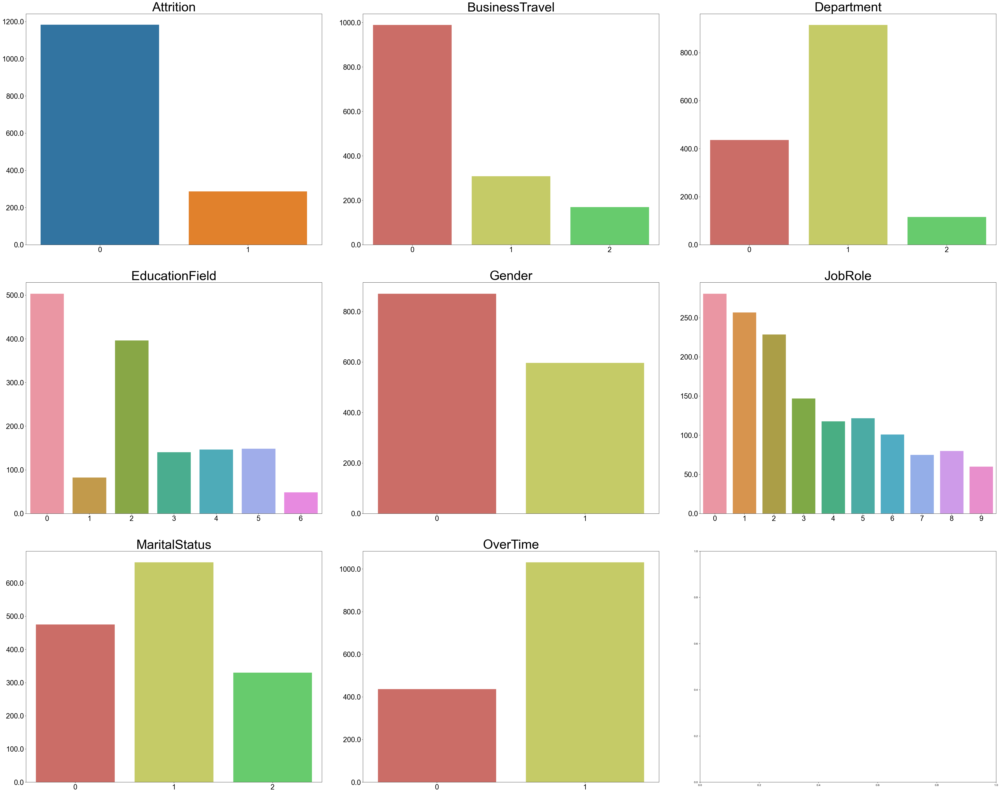

In [98]:
fig, axs = plt.subplots(nrows=3, ncols=3, figsize=(50, 40))
axs = axs.flatten()
for i, col in enumerate(["Attrition", "BusinessTravel", "Department", "EducationField", 
                        "Gender","JobRole", "MaritalStatus", "OverTime", 
                        ]):
    sns.countplot(x=col, data=df, ax=axs[i])
    axs[i].set_xlabel("")
    axs[i].set_xticklabels(axs[i].get_xticks(), size = 25)
    axs[i].set_ylabel("")
    axs[i].set_yticklabels(axs[i].get_yticks(), size = 25)
    axs[i].set_title(f"{col}", fontsize=45)
    sns.set(style="darkgrid", palette="hls")
plt.tight_layout(pad=5)    
plt.show()

In [99]:
df.corr(method="pearson")

,Age,Attrition,DailyRate,DistanceFromHome,Education,EmployeeCount,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,JobSatisfaction,MonthlyIncome,MonthlyRate,NumCompaniesWorked,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
Age,1,-0.0705875,0.00961368,-0.00116222,0.187838,-0.0031722,-0.0111628,0.026632,0.0221648,0.478234,-0.00866123,0.463809,0.0229089,0.287907,0.00702387,0.0190409,0.025682,-0.0107084,0.0372202,0.63933,-0.0191575,-0.0333721,0.28022,0.207037,0.216966,0.203085
Attrition,-0.0705875,1,-0.0680267,0.0516156,0.0141414,-0.012872,-0.0511229,-0.0218266,-0.0746167,-0.10946,-0.0745074,-0.103923,0.0317045,0.0380843,0.00905762,0.006643,-0.022145,0.0360812,-0.0873327,-0.113329,-0.0409204,-0.0400284,-0.0852203,-0.0978276,-0.0384353,-0.109914
DailyRate,0.00961368,-0.0680267,1,0.00628982,-0.00446968,0.0262788,0.0278709,0.0242576,0.0460539,0.00584553,0.0286592,0.0127708,-0.0476585,0.0637465,0.0107383,0.000563073,0.0088976,-0.0397927,0.0119143,0.0118853,-0.0303181,-0.0231557,-0.0225421,0.0138399,-0.0308226,-0.0254799
DistanceFromHome,-0.00116222,0.0516156,0.00628982,1,0.0197924,-0.0164863,-0.0277237,0.0192623,0.000841951,0.0287539,0.0166813,0.00767847,0.0135175,-0.00495222,0.0295852,-0.00312571,0.0167466,-0.0113933,0.0293445,0.0174369,-0.0568909,-0.00246384,0.0470365,0.018791,0.0246375,0.0526845
Education,0.187838,0.0141414,-0.00446968,0.0197924,1,-0.0338637,0.0119007,0.00634461,0.0306553,0.0940463,0.00134778,0.0900384,-0.0139595,0.111706,-0.0169088,-0.02733,-0.0134094,0.0045462,0.00766762,0.12073,-0.0378019,-0.00414638,0.0777925,0.0600249,0.0549299,0.0669706
EmployeeCount,-0.0031722,-0.012872,0.0262788,-0.0164863,-0.0338637,1,0.0283757,0.0551164,-0.0431632,0.00421529,0.0116465,0.00703184,-0.0373447,0.008713,-0.0022469,-0.00572913,-0.000474652,-0.00516665,-0.02942,0.00413674,-0.0523471,0.00432298,0.0165573,0.00858332,-0.000235298,-0.0103899
EnvironmentSatisfaction,-0.0111628,-0.0511229,0.0278709,-0.0277237,0.0119007,0.0283757,1,-0.0172205,-0.0213284,0.00434683,-0.0251431,0.00065075,0.0205153,0.000126156,0.00211848,0.0031657,0.0278963,-0.0250174,0.00419234,-0.0115869,-0.0367084,0.0337472,-0.0281548,-0.012339,-0.00169299,-0.0333783
HourlyRate,0.026632,-0.0218266,0.0242576,0.0192623,0.00634461,0.0551164,-0.0172205,1,0.025162,0.010019,-0.0384167,0.0194151,-0.0162128,0.0401165,-0.0250269,-0.0370056,-0.00134217,-0.0165354,0.0411942,0.043278,-0.0326346,-0.0218085,0.0188528,0.00797143,0.00788265,0.00819318
JobInvolvement,0.0221648,-0.0746167,0.0460539,0.000841951,0.0306553,-0.0431632,-0.0213284,0.025162,1,-0.0166616,-0.0190635,-0.0118988,-0.00129275,0.0061744,-0.0265489,-0.00795108,0.00496288,-0.0062835,0.00725092,0.000690822,-0.0418873,-0.0216542,0.0046619,0.0242824,0.0207913,0.0360321
JobLevel,0.478234,-0.10946,0.00584553,0.0287539,0.0940463,0.00421529,0.00434683,0.010019,-0.0166616,1,-0.0146025,0.935711,0.0428648,0.150019,-0.0192854,0.00628175,0.0155099,0.0268575,0.0129833,0.762137,-0.0365889,0.0383317,0.488184,0.378266,0.359852,0.366208


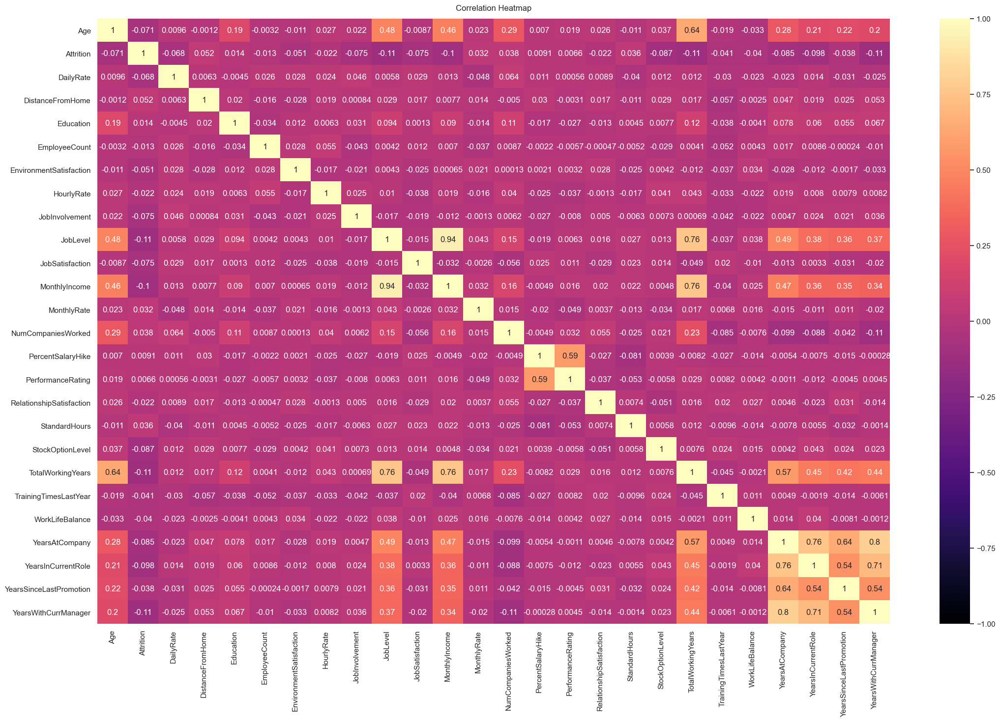

In [100]:
plt.figure(figsize=(26, 16))
heatmap = sns.heatmap(df.corr(), vmin=-1, vmax=1, cmap="magma", annot=True)
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':12}, pad=12);

In [101]:
df.shape

(1470, 33)

<span style="color: blue;">

### 3.2. Test Hypothesis <a class="anchor" id="13th-bullet"></a>
    
</span>

<span style="color: blue;">

### 3.2.1. T-Test Hypothesis <a class="anchor" id="19th-bullet"></a>
    
</span>

Importing relevant libraries. 

In [102]:
import scipy.stats as st
from scipy import stats

In [103]:
from scipy.stats import levene

In [104]:
from statsmodels.formula.api import ols
import statsmodels.api as sm

To perform test hypothesis variable "HourlyRate" is picked. Here is the distribution of the variable which shows that is close to normal distribution.

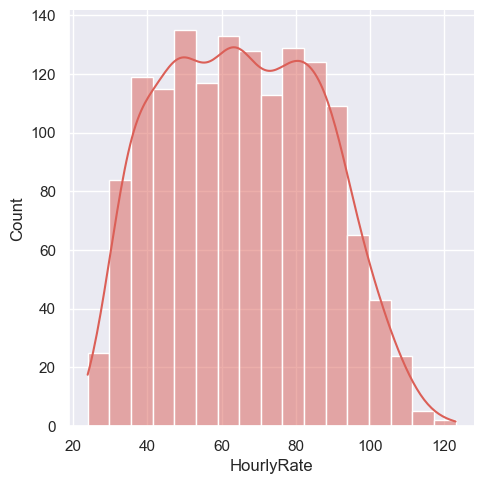

In [105]:
plot = sns.displot(df["HourlyRate"], kde = True)

In [106]:
X = df["HourlyRate"].values

In [107]:
mean = X.mean()

t.statistic value is often used for normally distibuted variables, especially when data sample is small. 

In [108]:
st.t.interval(alpha = 0.90, df = len(X)-1, loc = np.mean(X), scale = st.sem(X))

(64.67608963941325, 66.47765185718538)

To double check the results function .norm from scipy library is used and the results confirm the normal distribution of variable "HourlyRate"

In [109]:
stats.norm.interval(0.90,loc = np.mean(X),scale = st.sem(X))

(64.67665769523813, 66.4770838013605)

This is the result for all employees. Now let's see how it splits between two genders. To do that to hypotheses are created.

H0: Hourly rate for males and females is the same.
    
H1: Hourly rate for male and female is not the same.

In [110]:
F = df["HourlyRate"][df["Gender"] == "Female"]
M = df["HourlyRate"][df["Gender"] == "Male"]

Getting statistical values, needed for the t-test formula for both male and female.

In [111]:
F.describe()

count       598
mean    64.9337
std     21.0557
min       23.86
25%     47.5075
50%      64.905
75%      81.295
max      119.02
Name: HourlyRate, dtype: float64

In [112]:
M.describe()

count       872
mean    66.0179
std     20.9344
min       24.24
25%       48.58
50%      65.235
75%     83.0725
max       123.2
Name: HourlyRate, dtype: float64

Calculating 2-sample t-test.

In [113]:
t_test = stats.ttest_ind_from_stats(mean1 = 64.9338, std1 = 21.0556, nobs1 = 598, mean2 = 66.018, std2 = 20.9344, nobs2 = 872, equal_var = False)

print(t_test)

Ttest_indResult(statistic=-0.9720942067439607, pvalue=0.33118760545863535)


The result shows that pvalue (0.33) is greater than alpha, set at 0.05. Not enough evidence to reject the Null Hypothesis, meaning hourly rate for males and females is the same.

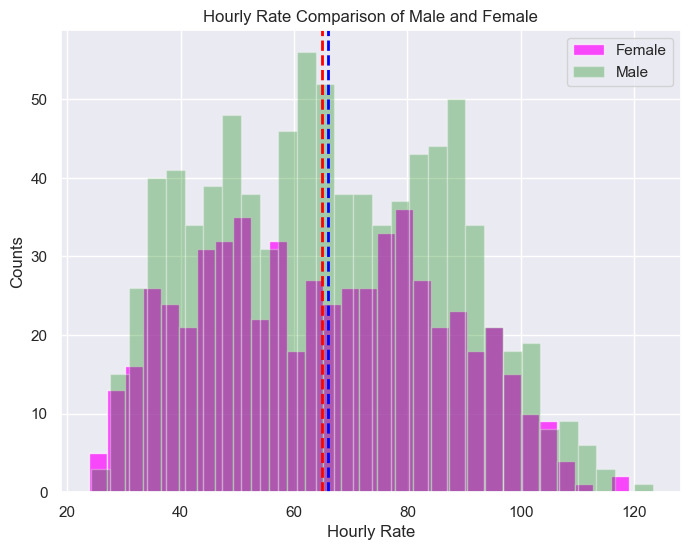

In [114]:
plt.figure(figsize=(8, 6))
plt.hist(F, bins=30, alpha=0.7, label="Female", color="magenta")
plt.hist(M, bins=30, alpha=0.3, label="Male", color="green")
plt.axvline(x=np.mean(F), color="red", linestyle="dashed", linewidth=2)
plt.axvline(x=np.mean(M), color="blue", linestyle="dashed", linewidth=2)
plt.xlabel("Hourly Rate")
plt.ylabel("Counts")
plt.title("Hourly Rate Comparison of Male and Female")
plt.legend()
plt.show()

T-test is enough when using just two populations. But when there are more population ANOVA (analysis of variance) is used. 

<span style="color: blue;">

### 3.2.2. ANOVA Hypothesis <a class="anchor" id="20th-bullet"></a>
    
</span>

Importing relevant library.

In [115]:
from scipy import stats

To perform ANOVA tests, variables "Department" and "HourlyRate" are used.

Variables used in ANOVA tests must meet three conditions. Checking distributions first.

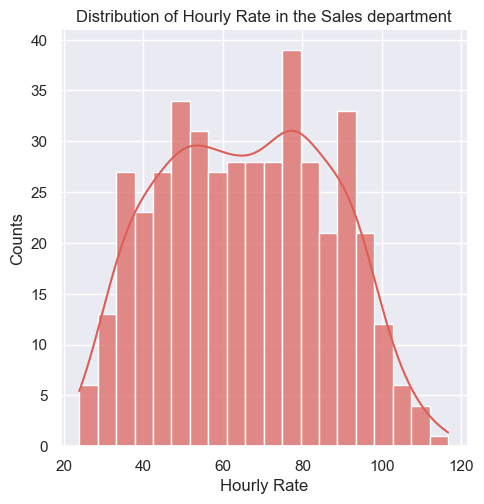

In [116]:
sales = df[df["Department"] == "Sales"]

sns.displot(data=sales, x="HourlyRate", kde=True, bins=20, alpha=0.7)
plt.xlabel("Hourly Rate")
plt.ylabel("Counts")
plt.title("Distribution of Hourly Rate in the Sales department")
plt.show()

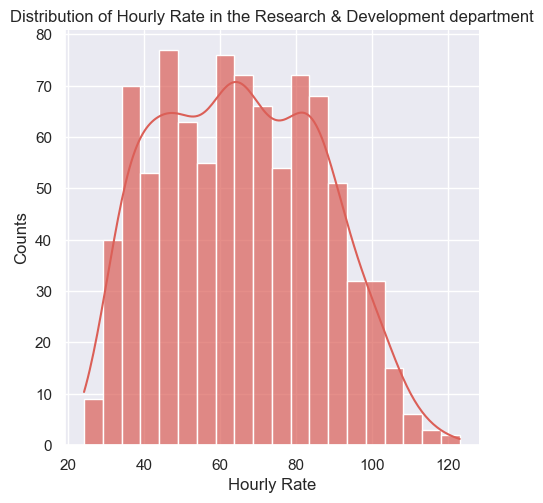

In [117]:
research = df[df["Department"] == "Research & Development"]

sns.displot(data=research, x="HourlyRate", kde=True, bins=20, alpha=0.7)
plt.xlabel("Hourly Rate")
plt.ylabel("Counts")
plt.title("Distribution of Hourly Rate in the Research & Development department")
plt.show()

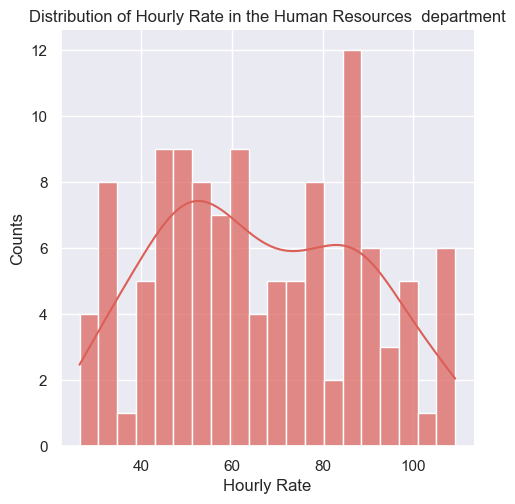

In [118]:
research = df[df["Department"] == "Human Resources"]

sns.displot(data=research, x="HourlyRate", kde=True, bins=20, alpha=0.7)
plt.xlabel("Hourly Rate")
plt.ylabel("Counts")
plt.title("Distribution of Hourly Rate in the Human Resources  department")
plt.show()

In [119]:
df[df["Department"] == "Human Resources"]["HourlyRate"].skew()

0.14304295636443268

In [120]:
stats.shapiro(df["HourlyRate"][df["Department"] =="Research & Development"])

ShapiroResult(statistic=0.97701495885849, pvalue=7.730528717164731e-11)

In [121]:
stats.shapiro(df["HourlyRate"][df["Department"] =="Sales"])

ShapiroResult(statistic=0.9759774804115295, pvalue=1.282679477299098e-06)

In [122]:
stats.shapiro(df["HourlyRate"][df["Department"] =="Human Resources"])

ShapiroResult(statistic=0.9666533470153809, pvalue=0.005222388543188572)

The result using Shapiro Wilk test doesn't satisfy conditions for ANOVA and these variables can't be used.

Trying next set of variables "Department" and "MonthlyIncome".

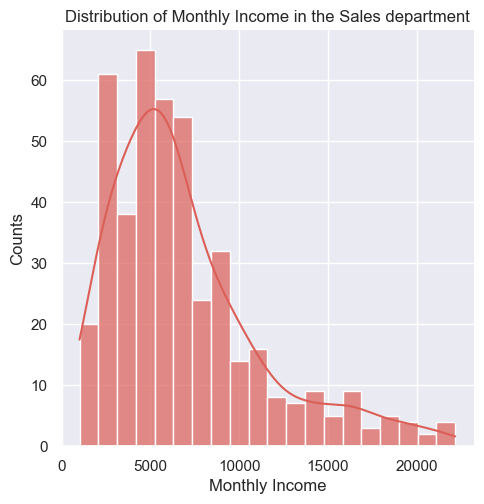

In [123]:
sales = df[df["Department"] == "Sales"]

sns.displot(data=sales, x="MonthlyIncome", kde=True, bins=20, alpha=0.7)
plt.xlabel("Monthly Income")
plt.ylabel("Counts")
plt.title("Distribution of Monthly Income in the Sales department")
plt.show()

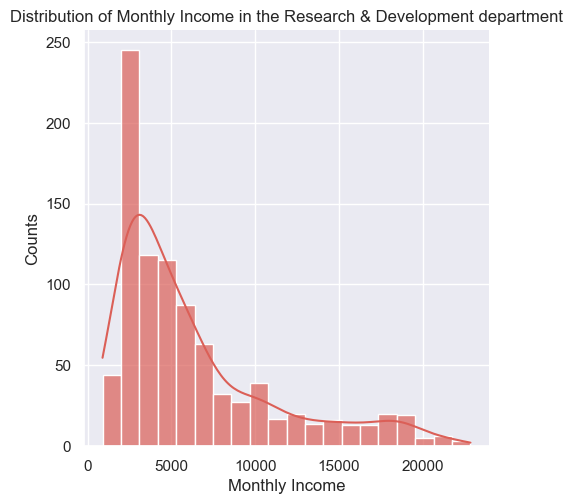

In [124]:
research = df[df["Department"] == "Research & Development"]

sns.displot(data=research, x="MonthlyIncome", kde=True, bins=20, alpha=0.7)
plt.xlabel("Monthly Income")
plt.ylabel("Counts")
plt.title("Distribution of Monthly Income in the Research & Development department")
plt.show()

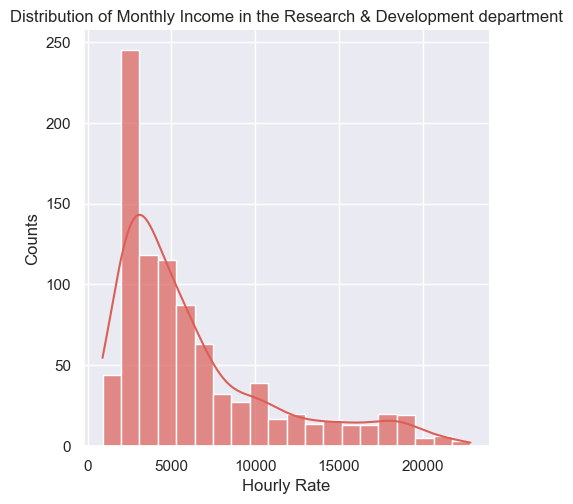

In [125]:
research = df[df["Department"] == "Research & Development"]

sns.displot(data=research, x="MonthlyIncome", kde=True, bins=20, alpha=0.7)
plt.xlabel("Hourly Rate")
plt.ylabel("Counts")
plt.title("Distribution of Monthly Income in the Research & Development department")
plt.show()

In [126]:
stats.shapiro(df["MonthlyIncome"][df["Department"] =="Research & Development"])

ShapiroResult(statistic=0.8192463517189026, pvalue=7.450388049607752e-31)

In [127]:
stats.shapiro(df["MonthlyIncome"][df["Department"] =="Sales"])

ShapiroResult(statistic=0.885846734046936, pvalue=1.7804070068468857e-17)

In [128]:
stats.shapiro(df["MonthlyIncome"][df["Department"] =="Human Resources"])

ShapiroResult(statistic=0.7663858532905579, pvalue=2.3187981482847286e-12)

In [129]:
research = df["MonthlyIncome"][df["Department"] =="Research & Development"]
sales = df["MonthlyIncome"][df["Department"] =="Sales"]
hr = df["MonthlyIncome"][df["Department"] =="Human Resources"]

Second condition is met, all the results are above 0.05, meaning the distributions are close to normal. Checking the last condition, levene test.

In [130]:
levene(research, sales, hr, center = "mean")

LeveneResult(statistic=3.9265095201975875, pvalue=0.019919874073689368)

The result is less than 0.05, condition isn't met.

Trying another set of variables "MaritalStatus" and "HourlyRate".

In [131]:
df["MaritalStatus"].value_counts()

Married     663
Single      476
Divorced    331
Name: MaritalStatus, dtype: int64

"MaritalStatus" has three values.

Probability plot is built.

<Figure size 640x480 with 0 Axes>

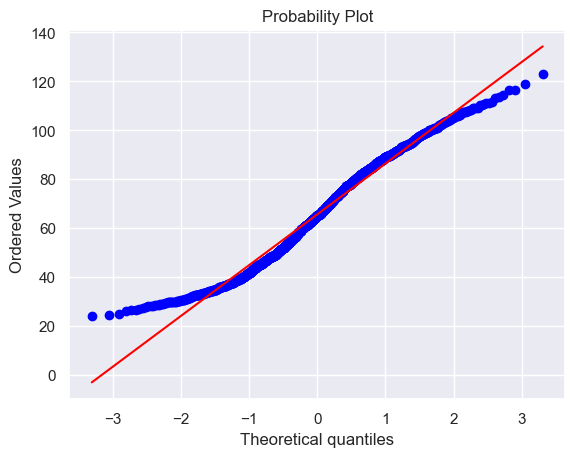

<Figure size 640x480 with 0 Axes>

In [132]:
stats.probplot(df["HourlyRate"], plot = plt)
plt.figure()

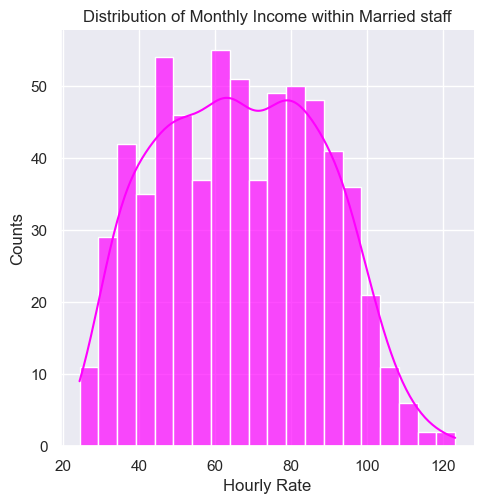

In [133]:
research = df[df["MaritalStatus"] == "Married"]

sns.displot(data=research, x="HourlyRate", kde=True, bins=20, alpha=0.7, color="magenta")
plt.xlabel("Hourly Rate")
plt.ylabel("Counts")
plt.title("Distribution of Monthly Income within Married staff")
plt.show()

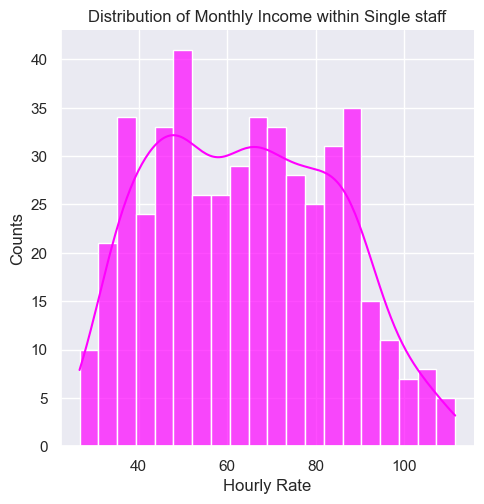

In [134]:
research = df[df["MaritalStatus"] == "Single"]

sns.displot(data=research, x="HourlyRate", kde=True, bins=20, alpha=0.7, color="magenta")
plt.xlabel("Hourly Rate")
plt.ylabel("Counts")
plt.title("Distribution of Monthly Income within Single staff")
plt.show()

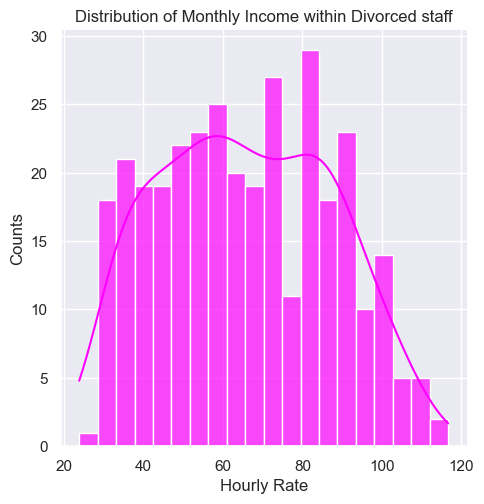

In [135]:
research = df[df["MaritalStatus"] == "Divorced"]

sns.displot(data=research, x="HourlyRate", kde=True, bins=20, alpha=0.7, color="magenta")
plt.xlabel("Hourly Rate")
plt.ylabel("Counts")
plt.title("Distribution of Monthly Income within Divorced staff")
plt.show()

Running shapiro tests.

In [136]:
stats.shapiro(df["HourlyRate"][df["MaritalStatus"] =="Married"])

ShapiroResult(statistic=0.9788312315940857, pvalue=3.356137412424687e-08)

In [137]:
stats.shapiro(df["HourlyRate"][df["MaritalStatus"] =="Single"])

ShapiroResult(statistic=0.9738977551460266, pvalue=1.657153347878193e-07)

In [138]:
stats.shapiro(df["HourlyRate"][df["MaritalStatus"] =="Divorced"])

ShapiroResult(statistic=0.974270761013031, pvalue=1.2295315173105337e-05)

In [139]:
married = df["HourlyRate"][df["MaritalStatus"] =="Married"]
single = df["HourlyRate"][df["MaritalStatus"] =="Single"]
divorced = df["HourlyRate"][df["MaritalStatus"] =="Divorced"]

In [140]:
levene(married, single, divorced, center = "mean")

LeveneResult(statistic=1.5451216471051052, pvalue=0.21363282140360362)

All 3 ANOVA conditions are met and it's time to move on with the hypothesis.

H0: Hourly rates are similar amongst all marital status people.
    
H1: At least one group is differently paid from the others.

In [141]:
model = ols("HourlyRate~MaritalStatus", data = df).fit()
aov = sm.stats.anova_lm(model, type = 2)
print(aov)

                df  sum_sq  mean_sq       F   PR(>F)
MaritalStatus    2 1652.07  826.033 1.87829 0.153218
Residual      1467  645156  439.779     NaN      NaN


This completes analysis's of the test hypothesis's

<span style="color: blue;">

### 3.3. Result Sets <a class="anchor" id="14th-bullet"></a>
    
</span>

Pairplot shows relationships between the variables.

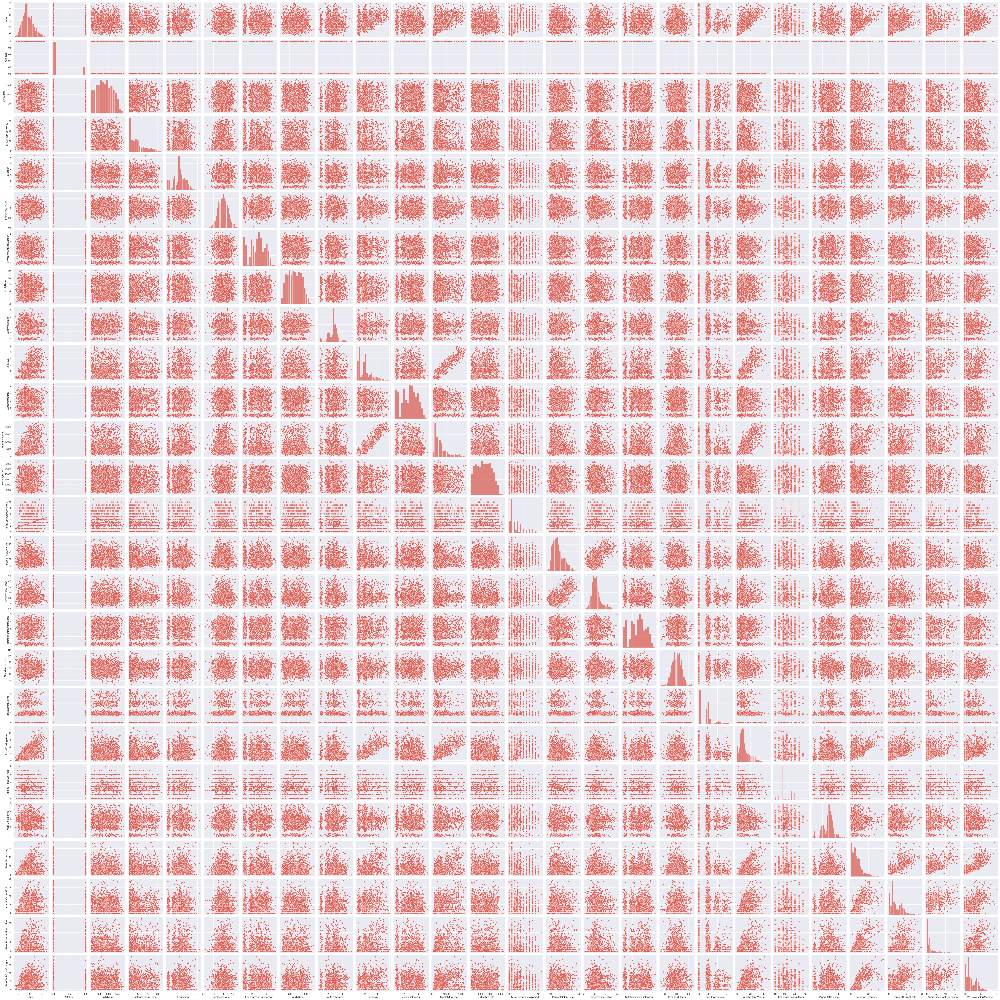

In [142]:
sns.pairplot(df)

In [143]:
from sklearn.metrics import r2_score 

Building scatterplot of variables "JobLevel" and "MonthlyIncome".

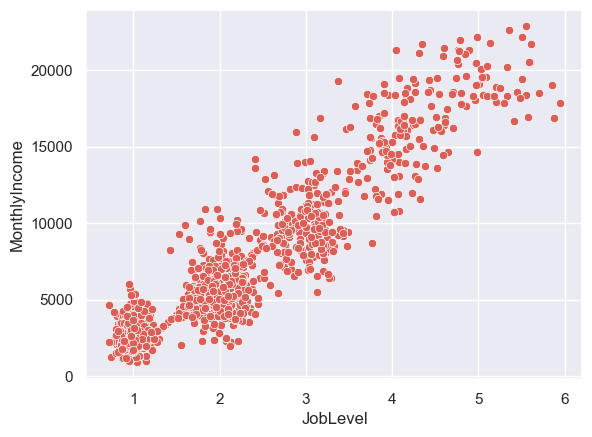

In [144]:
sns.scatterplot(data=df, x="JobLevel", y="MonthlyIncome");

In [145]:
df["JobLevel"].corr(df["MonthlyIncome"], method="pearson")

0.9357111449825135

In [146]:
df_fit = np.polyfit(df["JobLevel"], df["MonthlyIncome"], 1)

df_fit

array([ 3974.43175778, -1666.62990677])

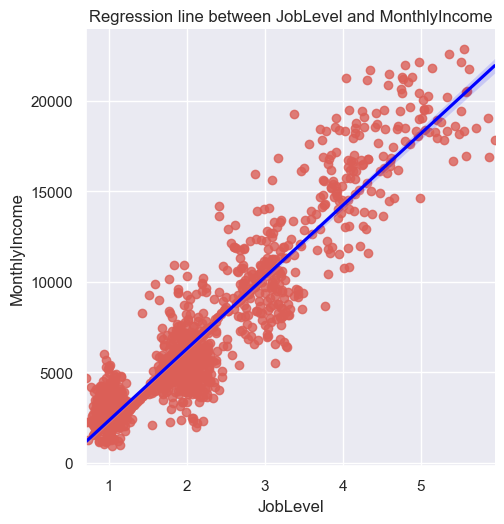

In [147]:
sns.lmplot(x="JobLevel", y="MonthlyIncome", data=df, line_kws={"color": "blue"})
plt.title("Regression line between JobLevel and MonthlyIncome")
plt.show()

<span style="color: blue;">

## 4. Mashine Learning <a class="anchor" id="sixth-bullet"></a>
    
</span>

Scaled and encoded dataframe df_encoded is used for mashine learning models.

In [148]:
df_encoded.head()

,Age,Attrition,DailyRate,DistanceFromHome,Education,EmployeeCount,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,JobSatisfaction,MonthlyIncome,MonthlyRate,NumCompaniesWorked,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,BusinessTravel_Travel_Frequently,BusinessTravel_Travel_Rarely,Department_Research & Development,Department_Sales,EducationField_Life Sciences,EducationField_Marketing,EducationField_Medical,EducationField_Other,EducationField_Technical Degree,EducationField_Unknown,Gender_Male,JobRole_Human Resources,JobRole_Laboratory Technician,JobRole_Manager,JobRole_Manufacturing Director,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative,JobRole_Unknown,MaritalStatus_Married,MaritalStatus_Single,OverTime_Yes
0,42,1,0.45963,0.00819921,1.77031,1.0333,2.14629,93.83,3.42696,2.46449,3.39767,0.252542,0.916753,7,9.89877,2.8449,1.01283,95.6,0,8.1,0,1.0521,5.8,0.209424,0,4.6,0,1,0,1,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,1
1,52,0,-1.31218,0.026116,1.03533,0.944859,3.4708,52.3,1.81346,1.7887,1.58406,0.162346,1.48597,1,20.1189,4.12028,4.31201,85.4,1.10464,9,3,2.52647,10.1,0.413613,1,5.9,1,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0
2,33,1,0.991299,0.0440328,2.1188,0.810809,3.97942,87.27,1.87723,0.833488,3.30101,0.056134,-1.70605,6,15.4016,2.78117,2.33256,76.2,0,8.4,3,2.92478,0,0,0,0,0,1,1,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,1,1
3,35,0,1.36038,0.0665047,3.67067,0.822976,3.7347,56.38,2.93265,1.09537,3.22084,0.0855947,1.8123,1,9.75755,2.76958,3.02959,75.9,0,7.7,3,3.11705,8.4,0.293194,2.8,0,1,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1
4,25,0,-0.794865,0.0376556,1.1205,0.822976,1.07941,40.43,3.11774,0.937746,1.69733,0.107578,0.469381,10,11.9201,3.28218,2.77663,72.7,0.953012,6.2,3,3.11232,2,0.104712,2.5,2.2,0,1,1,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,1


In [149]:
df_encoded.shape

(1470, 49)

<span style="color: blue;">

### 4.1. Selecting Target Variable <a class="anchor" id="21th-bullet"></a>
    
</span>

Distribution of target variable "Attrition"

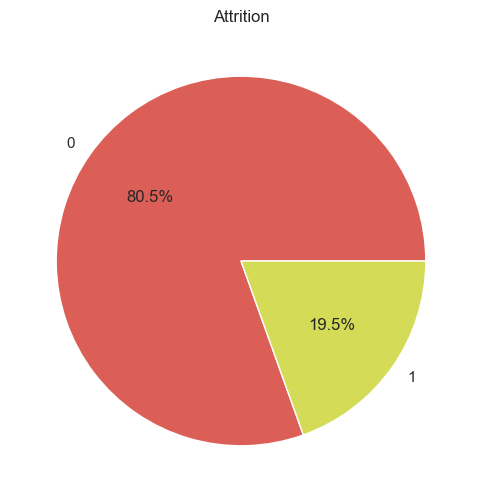

In [150]:
classes = df_encoded["Attrition"].value_counts()
plt.figure(figsize=(6, 6))  
plt.pie(classes, labels=classes.index, autopct='%1.1f%%')
plt.title("Attrition")
plt.show()

Setting Target variable.

In [151]:
X = df_encoded.drop("Attrition", axis=1) 
y = df_encoded["Attrition"]

<span style="color: blue;">

### 4.2. Mashine Learning models <a class="anchor" id="16th-bullet"></a>
    
</span>

Importing relevant libraries for training and testing and building confusion matrix.

In [152]:
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import train_test_split

Splitting the dataset. Test_size = 0.2.

In [153]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X.head()

,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,JobSatisfaction,MonthlyIncome,MonthlyRate,NumCompaniesWorked,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,BusinessTravel_Travel_Frequently,BusinessTravel_Travel_Rarely,Department_Research & Development,Department_Sales,EducationField_Life Sciences,EducationField_Marketing,EducationField_Medical,EducationField_Other,EducationField_Technical Degree,EducationField_Unknown,Gender_Male,JobRole_Human Resources,JobRole_Laboratory Technician,JobRole_Manager,JobRole_Manufacturing Director,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative,JobRole_Unknown,MaritalStatus_Married,MaritalStatus_Single,OverTime_Yes
0,42,0.45963,0.00819921,1.77031,1.0333,2.14629,93.83,3.42696,2.46449,3.39767,0.252542,0.916753,7,9.89877,2.8449,1.01283,95.6,0,8.1,0,1.0521,5.8,0.209424,0,4.6,0,1,0,1,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,1
1,52,-1.31218,0.026116,1.03533,0.944859,3.4708,52.3,1.81346,1.7887,1.58406,0.162346,1.48597,1,20.1189,4.12028,4.31201,85.4,1.10464,9,3,2.52647,10.1,0.413613,1,5.9,1,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0
2,33,0.991299,0.0440328,2.1188,0.810809,3.97942,87.27,1.87723,0.833488,3.30101,0.056134,-1.70605,6,15.4016,2.78117,2.33256,76.2,0,8.4,3,2.92478,0,0,0,0,0,1,1,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,1,1
3,35,1.36038,0.0665047,3.67067,0.822976,3.7347,56.38,2.93265,1.09537,3.22084,0.0855947,1.8123,1,9.75755,2.76958,3.02959,75.9,0,7.7,3,3.11705,8.4,0.293194,2.8,0,1,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1
4,25,-0.794865,0.0376556,1.1205,0.822976,1.07941,40.43,3.11774,0.937746,1.69733,0.107578,0.469381,10,11.9201,3.28218,2.77663,72.7,0.953012,6.2,3,3.11232,2,0.104712,2.5,2.2,0,1,1,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,1


#### Naive Bayes

First model tried is Naive Bayes. Importing relevant model.

In [154]:
from sklearn.naive_bayes import GaussianNB

In [155]:
classifier = GaussianNB()
classifier.fit(X_train, y_train)
y_pred = classifier.predict(X_test)

Calculating confusion matrix.

In [156]:
cm = confusion_matrix(y_test, y_pred)
accuracy_nb = (cm[0, 0] + cm[1, 1]) / (cm[0, 0] + cm[1, 1] + cm[0, 1] + cm[1, 0])
cm_bayes=cm
print("Confusion Matrix using Naive Bayes model:")
print(cm_bayes)
print("Accuracy is:", accuracy_nb)

Confusion Matrix using Naive Bayes model:
[[191  50]
 [ 28  25]]
Accuracy is: 0.7346938775510204


#### Random Forest

Next model tried is Random Forest. All the steps repeated as with Naive Bayes.

In [157]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report

In [158]:
rf_classifier = RandomForestClassifier(n_estimators=300, random_state=42)
rf_classifier.fit(X_train, y_train)
y_pred = rf_classifier.predict(X_test)
accuracy_rf = accuracy_score(y_test, y_pred)

In [159]:
cm = confusion_matrix(y_test, y_pred)
cm_rf = cm
print("Confusion Matrix using Random Forest:")
print(cm_rf)
print("Accuracy is:", accuracy_rf)

Confusion Matrix using Random Forest:
[[240   1]
 [ 51   2]]
Accuracy is: 0.8231292517006803


#### Support Vector Mashine

In [160]:
from sklearn.svm import SVC

In [161]:
sv_classifier = SVC(kernel="rbf") 

sv_classifier.fit(X_train, y_train)

y_pred_svc = sv_classifier.predict(X_test)
accuracy_svc = accuracy_score(y_test, y_pred_svc)

In [162]:
cm_svc = confusion_matrix(y_test, y_pred_svc)
print("Confusion Matrix using Support Vector Machine:")
print(cm_svc)
print("Accuracy is:", accuracy_svc)

Confusion Matrix using Support Vector Machine:
[[241   0]
 [ 53   0]]
Accuracy is: 0.8197278911564626


#### Logistic Regression

All the steps as previously.

In [163]:
from sklearn.linear_model import LogisticRegression

model = LogisticRegression()
model.fit(X_train, y_train)

y_pred = model.predict(X_test)

In [164]:
cm_lr = confusion_matrix(y_test, y_pred)
accuracy_lr = (cm_lr[0, 0] + cm_lr[1, 1]) / (cm_lr[0, 0] + cm_lr[1, 1] + cm_lr[0, 1] + cm_lr[1, 0])
print("Confusion Matrix using Linear Regression model:")
print(cm_lr)
print("Accuracy is:", accuracy_lr)

Confusion Matrix using Linear Regression model:
[[240   1]
 [ 49   4]]
Accuracy is: 0.8299319727891157


#### Desicion Tree

All the steps as previously.

In [165]:
from sklearn.tree import DecisionTreeClassifier
model = DecisionTreeClassifier() 
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

In [166]:
cm_dt = confusion_matrix(y_test, y_pred)
accuracy_dt = (cm_dt[0, 0] + cm_dt[1, 1]) / (cm_dt[0, 0] + cm_dt[1, 1] + cm_dt[0, 1] + cm_dt[1, 0])
print("Confusion Matrix using Desicion Tree model:")
print(cm_dt)
print("Accuracy is:", accuracy_dt)

Confusion Matrix using Desicion Tree model:
[[196  45]
 [ 42  11]]
Accuracy is: 0.7040816326530612


Comparison of the results for all 5 models.

In [167]:
accuracy_list = [accuracy_nb, accuracy_rf, accuracy_svc, accuracy_lr, accuracy_dt]  
true_positives_list = [cm_bayes[0, 0], cm_rf[0, 0], cm_svc[0, 0], cm_lr[0, 0], cm_dt[0, 0]]  
false_positives_list = [cm_bayes[1, 0], cm_rf[1, 0], cm_svc[1, 0], cm_lr[1, 0], cm_dt[1, 0]]  
true_negatives_list = [cm_bayes[1, 1], cm_rf[1, 1], cm_svc[1, 1], cm_lr[1, 1], cm_dt[1, 1]]  
false_negatives_list = [cm_bayes[0, 1], cm_rf[0, 1], cm_svc[0, 1], cm_lr[0, 1], cm_dt[0, 1]] 
models = ['Naive Bayes', 'Random Forest', "Support Vector", 'Logistic Regression', 'Decision Tree']
subtable = pd.DataFrame({
    'Model': models,
    'Accuracy': accuracy_list,
    "True Positive (Correct)": true_positives_list,
    "False Positive (Incorrect)": false_positives_list,
    "True Negative (Correct)": true_negatives_list,
    "False Negative (Incorrect)": false_negatives_list})
subtable.head()

,Model,Accuracy,True Positive (Correct),False Positive (Incorrect),True Negative (Correct),False Negative (Incorrect)
0,Naive Bayes,0.734694,191,28,25,50
1,Random Forest,0.823129,240,51,2,1
2,Support Vector,0.819728,241,53,0,0
3,Logistic Regression,0.829932,240,49,4,1
4,Decision Tree,0.704082,196,42,11,45


<span style="color: blue;">

### 4.3. Hyperparameter Tuning <a class="anchor" id="17th-bullet"></a>
    
</span>

Random Forest model is chosen for further analysis trying to achieve better accuracy and the next step is to tune hyperparameters. Importing relevant libraries.

In [168]:
rf_classifier = RandomForestClassifier(n_estimators=300, random_state=42)
rf_classifier.fit(X_train, y_train)
y_pred = rf_classifier.predict(X_test)
accuracy_rf = accuracy_score(y_test, y_pred)

In [169]:
cm = confusion_matrix(y_test, y_pred)
cm_rf = cm
print("Confusion Matrix using Random Forest:")
print(cm_rf)
print("Accuracy is:", accuracy_rf)

Confusion Matrix using Random Forest:
[[240   1]
 [ 51   2]]
Accuracy is: 0.8231292517006803


In [170]:
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV

Initial conditions are set having 6 folds for cross validation and range from 2 to 20 with a step of 4.

In [171]:
n_folds = 6

parameters = {"max_depth": range(2, 20, 4)}

rf = RandomForestClassifier()

rf = GridSearchCV(rf, parameters, 
                    cv=n_folds, 
                   scoring="accuracy")
rf.fit(X_train, y_train)

GridSearchCV(cv=6, estimator=RandomForestClassifier(),
             param_grid={'max_depth': range(2, 20, 4)}, scoring='accuracy')

In [172]:
scores = rf.cv_results_
pd.DataFrame(scores).head()

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_max_depth,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,split5_test_score,mean_test_score,std_test_score,rank_test_score
0,0.177484,0.0160959,0.00790381,0.00790537,2,{'max_depth': 2},0.80102,0.80102,0.80102,0.80102,0.80102,0.80102,0.80102,0,5
1,0.294295,0.0156801,0.0104229,0.0073701,6,{'max_depth': 6},0.80102,0.806122,0.80102,0.806122,0.80102,0.80102,0.802721,0.00240513,3
2,0.370939,0.0145899,0.0128291,0.00814757,10,{'max_depth': 10},0.811224,0.806122,0.795918,0.806122,0.790816,0.795918,0.80102,0.00721538,4
3,0.393948,0.0177556,0.0123674,0.00666027,14,{'max_depth': 14},0.806122,0.811224,0.80102,0.806122,0.806122,0.806122,0.806122,0.00294566,1
4,0.40091,0.00970636,0.0148692,0.00170781,18,{'max_depth': 18},0.806122,0.811224,0.806122,0.806122,0.795918,0.790816,0.802721,0.00701208,2


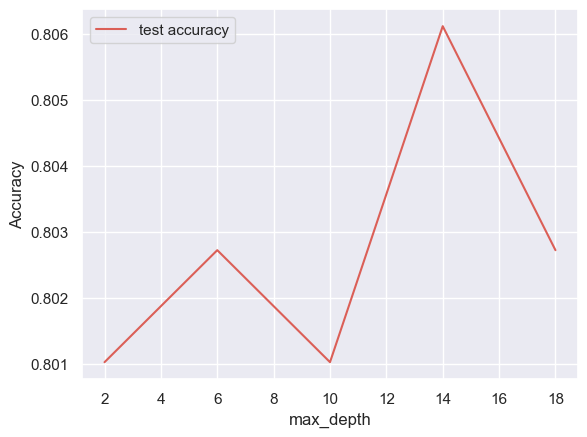

In [173]:
plt.figure()
plt.plot(scores["param_max_depth"], 
         scores["mean_test_score"], 
         label="test accuracy")
plt.xlabel("max_depth")
plt.ylabel("Accuracy")
plt.legend()
plt.show()

Create the parameter grid based on the results of random search. Instantiating grid search model. 

In [174]:
param_grid = {
    'max_depth': [12,14,16],
    'min_samples_leaf': range(100, 400, 200),
    'min_samples_split': range(200, 500, 200),
    'n_estimators': [100,200, 300], 
    'max_features': [5, 10]
}
rf = RandomForestClassifier()

grid_search = GridSearchCV(estimator = rf, param_grid = param_grid, 
                          cv = 3, n_jobs = -1,verbose = 1)

Fitting the grid search to the data.

In [175]:
grid_search.fit(X_train, y_train)

Fitting 3 folds for each of 72 candidates, totalling 216 fits


GridSearchCV(cv=3, estimator=RandomForestClassifier(), n_jobs=-1,
             param_grid={'max_depth': [12, 14, 16], 'max_features': [5, 10],
                         'min_samples_leaf': range(100, 400, 200),
                         'min_samples_split': range(200, 500, 200),
                         'n_estimators': [100, 200, 300]},
             verbose=1)

In [176]:
print('We can get accuracy of',grid_search.best_score_,'using',grid_search.best_params_)

We can get accuracy of 0.8010204081632653 using {'max_depth': 12, 'max_features': 5, 'min_samples_leaf': 100, 'min_samples_split': 200, 'n_estimators': 100}


Building model using the calculated parameters.

In [177]:
from sklearn.ensemble import RandomForestClassifier
rfc = RandomForestClassifier(bootstrap=True,
                             max_depth=10,
                             min_samples_leaf=100, 
                             min_samples_split=200,
                             max_features=10,
                             n_estimators=100)

In [178]:
rfc.fit(X_train,y_train)

RandomForestClassifier(max_depth=10, max_features=10, min_samples_leaf=100,
                       min_samples_split=200)

In [179]:
predictions = rfc.predict(X_test)

In [180]:
from sklearn.metrics import classification_report,confusion_matrix

Building classification report.

In [181]:
print(classification_report(y_test,predictions))

              precision    recall  f1-score   support

           0       0.82      1.00      0.90       241
           1       0.00      0.00      0.00        53

    accuracy                           0.82       294
   macro avg       0.41      0.50      0.45       294
weighted avg       0.67      0.82      0.74       294



In [182]:
print(confusion_matrix(y_test,predictions))

[[241   0]
 [ 53   0]]


<span style="color: blue;">

### 4.4. Cross validation scores using Logistic Regression <a class="anchor" id="23th-bullet"></a>
    
</span>

In [183]:
from sklearn.model_selection import cross_val_score

Training and testing LR model at different test sizes.

In [184]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42)

In [185]:
model = LogisticRegression()
model.fit(X_train, y_train)

y_pred = model.predict(X_test)

In [186]:
cm_lr10 = confusion_matrix(y_test, y_pred)
accuracy_lr10 = (cm_lr10[0, 0] + cm_lr10[1, 1]) / (cm_lr10[0, 0] + cm_lr10[1, 1] + cm_lr10[0, 1] + cm_lr10[1, 0])
print("Confusion Matrix using Linear Regression model:")
print(cm_lr10)
print("Accuracy is:", accuracy_lr10)

Confusion Matrix using Linear Regression model:
[[116   0]
 [ 30   1]]
Accuracy is: 0.7959183673469388


In [187]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [188]:
model = LogisticRegression()
model.fit(X_train, y_train)

y_pred = model.predict(X_test)

In [189]:
cm_lr20 = confusion_matrix(y_test, y_pred)
accuracy_lr20 = (cm_lr20[0, 0] + cm_lr20[1, 1]) / (cm_lr20[0, 0] + cm_lr20[1, 1] + cm_lr20[0, 1] + cm_lr20[1, 0])
print("Confusion Matrix using Linear Regression model:")
print(cm_lr20)
print("Accuracy is:", accuracy_lr20)

Confusion Matrix using Linear Regression model:
[[240   1]
 [ 49   4]]
Accuracy is: 0.8299319727891157


In [190]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [191]:
model = LogisticRegression()
model.fit(X_train, y_train)

y_pred = model.predict(X_test)

In [192]:
cm_lr30 = confusion_matrix(y_test, y_pred)
accuracy_lr30 = (cm_lr30[0, 0] + cm_lr30[1, 1]) / (cm_lr30[0, 0] + cm_lr30[1, 1] + cm_lr30[0, 1] + cm_lr30[1, 0])
print("Confusion Matrix using Linear Regression model:")
print(cm_lr30)
print("Accuracy is:", accuracy_lr)

Confusion Matrix using Linear Regression model:
[[361   4]
 [ 70   6]]
Accuracy is: 0.8299319727891157


 Creating accuracies subtable at different test sizes

In [193]:
accuracies = [accuracy_lr10, accuracy_lr20, accuracy_lr30]  
true_positives_list = [cm_lr10[0, 0], cm_lr20[0, 0], cm_lr30[0, 0]]  
false_positives_list = [cm_lr10[1, 0], cm_lr20[1, 0], cm_lr30[1, 0]]  
true_negatives_list = [cm_lr10[1, 1], cm_lr20[1, 1], cm_lr30[1, 1]]  
false_negatives_list = [cm_lr10[0, 1], cm_lr20[0, 1], cm_lr30[0, 1]] 
test_size = ["10%", "20%", "30%"]
subtable = pd.DataFrame({
    "Test Size": test_size,
    'Accuracy': accuracies,
    "True Positive (Correct)": true_positives_list,
    "False Positive (Incorrect)": false_positives_list,
    "True Negative (Correct)": true_negatives_list,
    "False Negative (Incorrect)": false_negatives_list})
subtable.head()

,Test Size,Accuracy,True Positive (Correct),False Positive (Incorrect),True Negative (Correct),False Negative (Incorrect)
0,10%,0.795918,116,30,1,0
1,20%,0.829932,240,49,4,1
2,30%,0.8322,361,70,6,4


Setting test size at 20% for cross validation

In [194]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

Calculating cross validation scores at 10 folds

In [195]:
cvs = cross_val_score(estimator = model, X = X_train, y = y_train, cv = 10)
print(cvs, "\n Mean Accuracy :", cvs.mean(), "\nStandard Deviation :", cvs.std())

[0.80508475 0.79661017 0.77966102 0.77966102 0.79661017 0.77118644
 0.78632479 0.82051282 0.8034188  0.77777778] 
 Mean Accuracy : 0.7916847747356222 
Standard Deviation : 0.014588622775657022


Calculating cross validation scores at 20 folds

In [196]:
cvs = cross_val_score(estimator = model, X = X_train, y = y_train, cv = 20)
print(cvs, "\n Mean Accuracy :", cvs.mean(), "\nStandard Deviation :", cvs.std())

[0.79661017 0.79661017 0.77966102 0.76271186 0.77966102 0.79661017
 0.79661017 0.79661017 0.81355932 0.77966102 0.79661017 0.76271186
 0.79661017 0.79661017 0.79661017 0.83050847 0.81034483 0.81034483
 0.77586207 0.81034483] 
 Mean Accuracy : 0.7942431326709526 
Standard Deviation : 0.016554046723755787


Calculating cross validation scores at 30 folds

In [197]:
cvs = cross_val_score(estimator = model, X = X_train, y = y_train, cv = 30)
print(cvs, "\n Mean Accuracy :", cvs.mean(), "\nStandard Deviation :", cvs.std())

[0.8        0.8        0.8        0.8        0.8        0.775
 0.76923077 0.82051282 0.82051282 0.82051282 0.84615385 0.79487179
 0.82051282 0.79487179 0.79487179 0.79487179 0.74358974 0.74358974
 0.82051282 0.79487179 0.79487179 0.79487179 0.79487179 0.82051282
 0.82051282 0.79487179 0.79487179 0.82051282 0.79487179 0.79487179] 
 Mean Accuracy : 0.799337606837607 
Standard Deviation : 0.021396870869039214


This completes Mashine Learning section.

<span style="color: blue;">

### Bibliography <a class="anchor" id="7th-bullet"></a>
    
</span>

https://datasciencestunt.com/regression-imputation/
    
    
https://vitalflux.com/pandas-impute-missing-values-mean-median-mode/#:~:text=df.mean())-,Impute%20%2F%20Replace%20Missing%20Values%20with%20Median%20in%20Python,for%20replacing%20the%20missing%20values.    
    
https://datatab.net/tutorial/levene-test    